#**Investigating the impact of​ individual data augmentation techniques​ on skin lesion classification**

**You can either run this code to preprocess the data downloaded straight from the ISIC website, or you can run it with data that has already been preprocessed with the code in the 'Data preprocessing' section. The preprocessing stage takes around 25 minutes to preprocess the data downloaded straight from ISIC. Links to both .zip files are in the word document titled 'Google_Drive_links_to_datasets' in the zip file uploaded to moodle. If not running on Colab I have included a requirements.txt**

#To run the code, there are two cells to note:

##'Setting file locations'

###general file locations

  - 'main_directory_for_all' changes where everything will be saved to - like results and augmented data; images generated by cGAN and basic augmentations during runtime

  - 'temporary_storage_path' is where items will be saved to during runtime but does not need to be saved permanently. On Colab this is the /content folder but on pycharm this will likely need to be set as an actual file location. Contents in this file location can be deleted after each run.

###file locations for preprocessing data

  - 'unclean_zip_path' is where the zip folder of unprocessed ISIC 2019 challenge data, 'ISIC_2019_Training_Input.zip', is saved on the computer

  - 'original_csv_path' is where the original ground truth csv, 'ISIC_2019_Training_GroundTruth.csv', is saved on the computer

###file locations for running code with cleaned data

  - 'saved_zip_path' is where the processed data, 'processedData.zip', is saved on the computer. If the program has been run with the data preprocessing stage, this can be set to be the same as 'path_to_save_clean_zip'

  - 'save_plots_for_presentation_location' is where the pre saved graphs are stored on the computer. These are in the .zip file as well in a folder called 'savedPLOTS'. They are uploaded as some of the visualisation will not work on other devices as they are taken from my results which are scattered across various files in my drive


##'More setup' -> 'Setting dataset and model hyperparameters':

###This is where you can change the hyperparameters depending on what type of test you are conducting. To check the code works use:

  - currentDataset = smaller_unzipped_path

  - CNN_Epochs = 2

  - GAN_epochs = 2

###To run a complete test of the code:

  - currentDataset = unzipped_path

  - CNN_Epochs = 30

  - GAN_epochs = 10


**Also it is worth noting that the visualisation cells in bold will not run on another device. The 'backup' visualisation cells, underneath each visualisation cell, also in bold, will output the pre saved visualisations taken from the full run of my code.**


#Initial setup ..



downloading libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.optim.lr_scheduler import _LRScheduler
import torch.utils.data as data
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from torch.optim.lr_scheduler import ReduceLROnPlateau

import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models
from torchvision.datasets import ImageFolder

from sklearn import decomposition
from sklearn import manifold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm.notebook import tqdm, trange
import matplotlib.pyplot as plt
import numpy as np

import copy
from collections import namedtuple
import os
import random
import shutil
import time
import collections
import math
import pandas as pd
import copy
import csv

import argparse
import os
import numpy as np
import math

import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

from datetime import datetime

import torchvision
from PIL import Image
from torch.optim.lr_scheduler import ReduceLROnPlateau
import pandas as pd
from sklearn.model_selection import train_test_split

from PIL import Image
from collections import defaultdict

from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, roc_curve, auc
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


import torchvision.transforms.functional as F
from PIL import Image

import zipfile

create seed for reproducibility

In [ ]:
SEED = 1234

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

mount google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


#Setting file locations

In [ ]:
##General file locations##
    #Ones that need changing#
main_directory_for_all  = "/content/drive/MyDrive/Synoptic_Final/paths10" #this is the main directory that everything is saved to - results etc
temporary_storage_path = "/content" #where items can be saved to while program is running
    #Ones that don't need changing
datasets_path = os.path.join(temporary_storage_path, "Datasets")
os.makedirs(datasets_path, exist_ok=True) #where datasets are saved to while program is running

##File locations for data preprocessing##
    #Ones that need changing
unclean_zip_path = "/content/drive/MyDrive/Synoptic 2/ISIC_2019_Training_Input(1).zip" #this is where you have saved the unclean .zip file
original_csv_path =  "/content/drive/MyDrive/Synoptic 2/ISIC_2019_Training_GroundTruth.csv" #this is where you have saved the ground truth csv
    #Ones that don't need changing
path_to_save_clean_zip = os.path.join(main_directory_for_all, "cleaned_data.zip")


##File locations for running with cleaned data##
    #One that needs changing
saved_zip_path = "/content/drive/MyDrive/Synoptic 2/processedData.zip" #path to where zip file is stored containing image data
    #Ones that don't need changing
unzipped_path = os.path.join(datasets_path, "unzipped")
data_and_graphs_path = os.path.join(main_directory_for_all, "Data_and_Graphs") #path to where results and graphs will be saved to
os.makedirs(data_and_graphs_path, exist_ok=True)

##file location for pre saved plots, just in case code for visualisation doesn't work for presentation
save_plots_for_presentation_location = "/content/drive/MyDrive/Synoptic_Final/savedPLOTS"

#Data preprocessing

unpacking original images folder

In [ ]:
shutil.unpack_archive(unclean_zip_path, datasets_path)

making a copy of original csv so that the original csv does not accidently get editted

In [ ]:
dataframe = pd.read_csv(original_csv_path) #original csv

copyof_csv_path = os.path.join(main_directory_for_all, "temp_ISIC_2019_Training_GroundTruth.csv")

dataframe.to_csv(copyof_csv_path, index = False) #copy

##Missing / incorrect data

verifying that no entrys contain more than one disease or no diseases



In [ ]:
df = pd.read_csv(copyof_csv_path) #load csv file

#check if any image portrays more than one disease

disease_df = df.iloc[:, 1:]

multiple_diseases = disease_df[disease_df.sum(axis=1) > 1] #create directory for diseases which columns add up to more than one

if not multiple_diseases.empty:
    print("Images portraying more than one disease:")
    print(multiple_diseases)
else:
    print("No images portray more than one disease.")


#check if any image portrays more than one disease

no_diseases = disease_df[disease_df.sum(axis=1) > 1] #create directory for diseases which columns add up to less than one

if not multiple_diseases.empty:
    print("Images portraying no diseases:")
    print(no_diseases)
else:
    print("No images portray no diseases.")

#NOTE: the folder does not contain any images portraying >1 or <1 diseases, so no function is written to remove these images

No images portray more than one disease.
No images portray no diseases.


##removing duplicate images

function to find duplicate images through hash function

In [ ]:
def find_duplicates(folder_path):
    duplicateImages = defaultdict(list) #create a list to store hash functions of duplicate images

    #iterate through all files in the folder
    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)
        if os.path.isfile(file_path):
            try:
                with Image.open(file_path) as img: #open the image file
                    img_hash = hash(img.tobytes()) #calculate a hash for the image
                    duplicateImages[img_hash].append(file_path) #add the file name to the list of files with the same hash
            except Exception as e:
                print(f"Error processing {filename}: {e}") #exception is needed as there are some license files etc contained in the data

    duplicateImages = {img_hash: filenames for img_hash, filenames in duplicateImages.items() if len(filenames) > 1} #filter out unique images by only leaving entries who's hash appears more than once

    return duplicateImages

function for showing file names of duplicate images

In [ ]:
def show_duplicate_files(duplicate_files):
  for img_hash, filenames in duplicate_files.items():
        print(f"Hash: {img_hash}")
        print(f"Duplicate Files: {filenames}") #prints the contents of duplicate_files list
  print("no more duplicates") #until there are no more duplicates to show

function to delete the duplicate files from images folder

In [ ]:
def delete_duplicates(duplicate_files):
    for img_hash, filenames in duplicate_files.items():
        for file_to_delete in filenames[1:]: #keep the first file, delete the rest
            os.remove(file_to_delete)
            print(f"Deleted: {file_to_delete}")

function to remove the entries of duplicate images in the csv file

In [ ]:
def delete_duplicates_from_csv(duplicate_files):
  duplicate_filenames = []
  for img_hash, filenames in duplicate_files.items():  #finding list of filenames to delete
        for file_to_delete in filenames[1:]: #keeping the first file name from duplicate_files, delete the rest
            filename = os.path.basename(file_to_delete).replace('.jpg', '') #removing .jpg from file name as this is not in the csv
            duplicate_filenames.append(filename)

  input_csv_path = copyof_csv_path #original csv

  output_csv_path = os.path.join(main_directory_for_all, "no_duplicates_ISIC_2019_Training_GroundTruth.csv")#new, clean csv

  open(output_csv_path, 'w').close() #deletes contents of output csv in case it has already been run and is populated

  with open(input_csv_path, mode='r', newline='', encoding='utf-8') as infile, \
     open(output_csv_path, mode='w', newline='', encoding='utf-8') as outfile: #open original csv to be read as infile and new clean csv to be written to as outfile

    reader = csv.reader(infile)
    writer = csv.writer(outfile)

    for row in reader:
        image_name = row[0] #image_name is first column of csv
        if image_name not in duplicate_filenames: #check that image_name isnt in list of duplicates
            writer.writerow(row) #add it to new csv

finding the duplicates and deleting them from image folder + csv

In [ ]:
folder_path = os.path.join(datasets_path, "ISIC_2019_Training_Input")
duplicate_files = find_duplicates(folder_path)
show_duplicate_files(duplicate_files)
delete_duplicates_from_csv(duplicate_files)
delete_duplicates(duplicate_files)

Error processing LICENSE.txt: cannot identify image file '/content/Datasets/ISIC_2019_Training_Input/LICENSE.txt'
Error processing ATTRIBUTION.txt: cannot identify image file '/content/Datasets/ISIC_2019_Training_Input/ATTRIBUTION.txt'
Hash: -6196007539766272129
Duplicate Files: ['/content/Datasets/ISIC_2019_Training_Input/ISIC_0054334.jpg', '/content/Datasets/ISIC_2019_Training_Input/ISIC_0056130.jpg']
Hash: -3063035232834921020
Duplicate Files: ['/content/Datasets/ISIC_2019_Training_Input/ISIC_0063226.jpg', '/content/Datasets/ISIC_2019_Training_Input/ISIC_0062259.jpg']
Hash: 5093514428662075753
Duplicate Files: ['/content/Datasets/ISIC_2019_Training_Input/ISIC_0054911.jpg', '/content/Datasets/ISIC_2019_Training_Input/ISIC_0062368.jpg']
Hash: -2567313937510422901
Duplicate Files: ['/content/Datasets/ISIC_2019_Training_Input/ISIC_0071101.jpg', '/content/Datasets/ISIC_2019_Training_Input/ISIC_0053812.jpg']
Hash: 6321684163164663625
Duplicate Files: ['/content/Datasets/ISIC_2019_Training

verifying there are no more duplicates after deleting

In [ ]:
duplicate_files = find_duplicates(folder_path)
show_duplicate_files(duplicate_files)

Error processing LICENSE.txt: cannot identify image file '/content/Datasets/ISIC_2019_Training_Input/LICENSE.txt'
Error processing ATTRIBUTION.txt: cannot identify image file '/content/Datasets/ISIC_2019_Training_Input/ATTRIBUTION.txt'
no more duplicates


##shuffling the dataset

In [ ]:
output_csv_path = os.path.join(main_directory_for_all, "no_duplicates_ISIC_2019_Training_GroundTruth.csv")
dataframe = pd.read_csv(output_csv_path) #

shuffled_csv_path = os.path.join(main_directory_for_all, "Shuffled_Ground_Truth.csv")
open(shuffled_csv_path, 'w').close()

dataframe['random_float'] = np.random.rand(dataframe.shape[0]) #add a new column with random floats between 0 and 1

shuffled_dataframe = dataframe.sort_values(by='random_float') #sort the dataframe by the random_float column to shuffle the dataset

shuffled_dataframe = shuffled_dataframe.drop('random_float', axis=1)
shuffled_dataframe = shuffled_dataframe.drop('UNK', axis=1) #there are no instances of UNK in the dataset, so it is removed

shuffled_dataframe.to_csv(shuffled_csv_path , index = False)

##creating and populating test train directories

creating directories for test train val and their subsets

In [ ]:
split_data_path = os.path.join(datasets_path, 'split_data')
os.makedirs(split_data_path, exist_ok=True)

os.makedirs(os.path.join(split_data_path, 'train'), exist_ok=True)
os.makedirs(os.path.join(split_data_path, 'val'), exist_ok=True)
os.makedirs(os.path.join(split_data_path, 'test'), exist_ok=True) #create train, test, val folders

#csv_file_path = '/content/drive/MyDrive/Synoptic 2/ISIC_2019_Training_GroundTruth.csv'
df = pd.read_csv(shuffled_csv_path)
diseases = df.columns[1:]

for disease in diseases:
  if disease != 'UNK':   #i do not include 'UNK' as there are no instances of it in the dataset
    os.makedirs(os.path.join(split_data_path, 'test', disease), exist_ok=True)
    os.makedirs(os.path.join(split_data_path, 'train', disease), exist_ok=True)
    os.makedirs(os.path.join(split_data_path, 'val', disease), exist_ok=True) #create subdirectories in test train val folders for each disease


finding number of images that are supposed to be in each folder / subfolder for verification

In [ ]:
file_path = shuffled_csv_path
ground_truth_data = pd.read_csv(file_path)

disease_counts = {} #create a dictionary to store the counts

#iterate over each disease column except image name column
for disease in ground_truth_data.columns[1:]:
  if disease != 'UNK':   #i do not include 'UNK' as there are no instances of it in the dataset
    # Count the number of positive cases for each disease
    name = disease
    count = ground_truth_data[disease].sum() #finds total number of entries
    #This is where the train, test, val ratios are set, currently set to 70:20:10
    trainCount = round(count * 0.7) #finds the number of entries for train set
    testCount = round(count * 0.2) #for test set
    valCount = count - (trainCount + testCount) #for val set
    disease_counts[disease] = {
        'name' : name,
        'count': int(count),
        'trainCount': int(trainCount),
        'testCount': int(testCount),
        'valCount': int(valCount)}


print(disease_counts) #output the disease counts

##adding them all up again for debug

total_train = 0
total_val = 0
total_test = 0

#iterate over each disease in the disease_counts dictionary
for disease, data in disease_counts.items():
    total_train += data['trainCount']
    total_val += data['valCount']
    total_test += data['testCount']

print(total_train + total_val + total_test) #just shows the total entries


{'MEL': {'name': 'MEL', 'count': 4512, 'trainCount': 3158, 'testCount': 902, 'valCount': 452}, 'NV': {'name': 'NV', 'count': 12864, 'trainCount': 9005, 'testCount': 2573, 'valCount': 1286}, 'BCC': {'name': 'BCC', 'count': 3316, 'trainCount': 2321, 'testCount': 663, 'valCount': 332}, 'AK': {'name': 'AK', 'count': 859, 'trainCount': 601, 'testCount': 172, 'valCount': 86}, 'BKL': {'name': 'BKL', 'count': 2610, 'trainCount': 1827, 'testCount': 522, 'valCount': 261}, 'DF': {'name': 'DF', 'count': 239, 'trainCount': 167, 'testCount': 48, 'valCount': 24}, 'VASC': {'name': 'VASC', 'count': 253, 'trainCount': 177, 'testCount': 51, 'valCount': 25}, 'SCC': {'name': 'SCC', 'count': 628, 'trainCount': 440, 'testCount': 126, 'valCount': 62}}
25281


In [ ]:
print(disease_counts.items()) #showing all disease counts for test train val folders

dict_items([('MEL', {'name': 'MEL', 'count': 4512, 'trainCount': 3158, 'testCount': 902, 'valCount': 452}), ('NV', {'name': 'NV', 'count': 12864, 'trainCount': 9005, 'testCount': 2573, 'valCount': 1286}), ('BCC', {'name': 'BCC', 'count': 3316, 'trainCount': 2321, 'testCount': 663, 'valCount': 332}), ('AK', {'name': 'AK', 'count': 859, 'trainCount': 601, 'testCount': 172, 'valCount': 86}), ('BKL', {'name': 'BKL', 'count': 2610, 'trainCount': 1827, 'testCount': 522, 'valCount': 261}), ('DF', {'name': 'DF', 'count': 239, 'trainCount': 167, 'testCount': 48, 'valCount': 24}), ('VASC', {'name': 'VASC', 'count': 253, 'trainCount': 177, 'testCount': 51, 'valCount': 25}), ('SCC', {'name': 'SCC', 'count': 628, 'trainCount': 440, 'testCount': 126, 'valCount': 62})])


populating directories

In [ ]:
csv_file_path = shuffled_csv_path #load the shuffled dataset csv
df = pd.read_csv(csv_file_path)

source_dir = os.path.join(datasets_path, "ISIC_2019_Training_Input") #source directory of unsorted ISIC images

base_dir = split_data_path #base directory for train test and val folders

folder_disease_counters = {
    'train': {},
    'test': {},
    'val': {}
} #initialize current counters for each folder and disease

#function to reset folder_disease_counters
def reset_counters():
    for disease in disease_counts:
        folder_disease_counters['train'][disease] = 0
        folder_disease_counters['test'][disease] = 0
        folder_disease_counters['val'][disease] = 0

reset_counters()  #initialize counters to 0

#function to distribute an image to the appropriate folder
def distribute_image(row):
    image_name = row['image'] + '.jpg'  #add jpg file extension as it is not in the csv
    for disease, counts in disease_counts.items():
        if row[disease] == 1:  #if the image is positive for the disease
            #determine the folder that is currently being populated based on the current counts
            if folder_disease_counters['train'][disease] < counts['trainCount']: #start with train, if current count is less than trainCount then it goes in the train folder
                target_folder = 'train'
            elif folder_disease_counters['test'][disease] < counts['testCount']: #then test
                target_folder = 'test'
            else:
                target_folder = 'val' #then val

            folder_disease_counters[target_folder][disease] += 1 #increment the current counter for the disease in the chosen folder

            #define source and target paths
            src_path = os.path.join(source_dir, image_name)
            target_path = os.path.join(base_dir, target_folder, disease, image_name)

            shutil.copy(src_path, target_path) #copy image to the target directory
            break  #break loop once image has been distributed

#iterate over all rows in DataFrame and distribute images
for index, row in df.iterrows():
    distribute_image(row)


##Verifying split data

verifying number of images in each subfolder is correct

In [ ]:
#function to count files in each class within train, test, and val folders
def count_files(base_dir):
    distributed_disease_counts = {}
    for folder in ['train', 'test', 'val']:
        print(f"Folder: {folder}")
        folder_path = os.path.join(base_dir, folder)
        for class_name in os.listdir(folder_path):
            class_path = os.path.join(folder_path, class_name)
            if os.path.isdir(class_path):
                file_count = len(os.listdir(class_path))
                print(f"Class: {class_name}, Files: {file_count}")
                #update the distributed_disease_counts dictionary
                if class_name not in distributed_disease_counts:
                    distributed_disease_counts[class_name] = {'train': 0, 'test': 0, 'val': 0}
                distributed_disease_counts[class_name][folder] = file_count
        print("--------------")

    #check if the counts match the expected counts
    for disease, data in disease_counts.items():
        if (data['trainCount'] != distributed_disease_counts[disease]['train'] or
            data['testCount'] != distributed_disease_counts[disease]['test'] or
            data['valCount'] != distributed_disease_counts[disease]['val']):
            print(f"Error: incorrect counts for {disease}")
    print("Correct number of images in each folder.")

base_dir = split_data_path

#call the function to count files and verify correctness
count_files(base_dir)


Folder: train
Class: MEL, Files: 3158
Class: VASC, Files: 177
Class: NV, Files: 9005
Class: SCC, Files: 440
Class: DF, Files: 167
Class: BKL, Files: 1827
Class: BCC, Files: 2321
Class: AK, Files: 601
--------------
Folder: test
Class: MEL, Files: 902
Class: VASC, Files: 51
Class: NV, Files: 2573
Class: SCC, Files: 126
Class: DF, Files: 48
Class: BKL, Files: 522
Class: BCC, Files: 663
Class: AK, Files: 172
--------------
Folder: val
Class: MEL, Files: 452
Class: VASC, Files: 25
Class: NV, Files: 1286
Class: SCC, Files: 62
Class: DF, Files: 24
Class: BKL, Files: 261
Class: BCC, Files: 332
Class: AK, Files: 86
--------------
Correct number of images in each folder.


finding any duplicate file names across folders / subfolders: correct number in each folder + no duplicates -> data correctly split

In [ ]:
import os

def list_files(directory): #creates a list of all files in a folder
    files_list = []
    for root, _, files in os.walk(directory):
        for file in files:
            files_list.append(os.path.join(root, file))
    return files_list

def find_duplicates(folders):
    all_files = {} #function to hold all files
    duplicates = {} #function to hold file names that appear more than once

    for folder in folders: #every folder
        files = list_files(folder)
        for file in files: #every file in every folder
            file_name = os.path.basename(file)
            if file_name in all_files: #check if file name already exists in the dictionary
                if file_name in duplicates: #if it does, append the new path
                    duplicates[file_name].append(file)
                else:
                    duplicates[file_name] = [all_files[file_name], file] #if not, create new entry in duplicates
            else:
                all_files[file_name] = file #adds the file to the all files list if it isn't already in it

    return duplicates


folders = [os.path.join(split_data_path, 'test'), os.path.join(split_data_path, 'train'), os.path.join(split_data_path, 'val')]

duplicates = find_duplicates(folders)

if duplicates:
    print("duplicate files found:")
    for file_name, paths in duplicates.items():
        print(f"File name: {file_name}")
        for path in paths:
            print(f" --Located at: {path}") #shows any duplicate file names
else:
    print("No duplicate files found")


No duplicate files found


##normalisation prep

finding means and stds of train set

In [ ]:
train_data_for_std = datasets.ImageFolder(root = os.path.join(split_data_path, 'train'),
                                  transform = transforms.ToTensor()) #turn data to tensor

normalisation_means = torch.zeros(3)
normalisation_stds = torch.zeros(3) #initialise to hold means values and standard deviation


for img, label in train_data_for_std:
    normalisation_means += torch.mean(img, dim = (1,2))
    normalisation_stds += torch.std(img, dim = (1,2)) #adding the mean and std for each image


normalisation_means /= len(train_data_for_std)
normalisation_stds /= len(train_data_for_std) #averaging the means and stds

print(f'Means: {normalisation_means}')
print(f'Stds: {normalisation_stds}')

Means: tensor([0.6684, 0.5296, 0.5244])
Stds: tensor([0.1342, 0.1484, 0.1599])


In [ ]:
normalisation_means_path = os.path.join(datasets_path, 'normalisation_means_torch.pt')
normalisation_stds_path = os.path.join(datasets_path, 'normalisation_stds_torch.pt')

torch.save(normalisation_means, normalisation_means_path)
torch.save(normalisation_stds, normalisation_stds_path) #saving the means and stds

In [ ]:
loaded_means = torch.load(normalisation_means_path)
loaded_stds = torch.load(normalisation_stds_path)

print(f'loaded means: {loaded_means}')
print(f'loaded stds: {loaded_stds}') #verifying the means and stds saved correctly, debug

loaded means: tensor([0.6684, 0.5296, 0.5244])
loaded stds: tensor([0.1342, 0.1484, 0.1599])


saving means and stds to files so they can be zipped.

##creating zip of prepped data and normalisation + std means

In [ ]:
#listing single files to include in the zip folder
files_to_zip = [normalisation_means_path, normalisation_stds_path]

#function to add whole directory to zip folder
def add_folder_to_zip(zipf, folder_path):
    for root, _, files in os.walk(folder_path):
        for file in files:
            file_path = os.path.join(root, file)
            zipf.write(file_path, os.path.relpath(file_path, folder_path))


directory_to_zip = split_data_path #path to directory of split image data

zip_folder_path = path_to_save_clean_zip #path to save the zip folder

if os.path.exists(zip_folder_path):
    os.remove(zip_folder_path)
    print("deleted existing zip folder") #deleting previous zip folder if it already exists

#create zip file
with zipfile.ZipFile(zip_folder_path, 'w') as zipf:
    add_folder_to_zip(zipf, directory_to_zip) #adding image folder
    for file in files_to_zip:
        zipf.write(file, os.path.basename(file)) #adding the means and STDs

print("created zip folder")


created zip folder


#More setup ..

##Unzip data

In [ ]:
shutil.unpack_archive(saved_zip_path, unzipped_path)

##Making smaller dataset --**only for dev stage**--

In [ ]:
smaller_unzipped_path = os.path.join(temporary_storage_path, "/Datasets/smaller_unzipped")

if os.path.exists(smaller_unzipped_path):
    shutil.rmtree(smaller_unzipped_path)
    print(f"Directory '{smaller_unzipped_path}' has been removed.")
else:
    print(f"Directory '{smaller_unzipped_path}' does not exist.") #this just resets the folder each time this is run


#function to copy a percentage of files from source directory to destination directory
def copy_percentage_of_files(source_dir, dest_dir, percentage):
    files = os.listdir(source_dir)
    num_files_to_copy = int(len(files) * percentage)

    #randomly select files to copy
    files_to_copy = random.sample(files, num_files_to_copy)

    #copy selected files to destination directory
    for file_name in files_to_copy:
        shutil.copy(os.path.join(source_dir, file_name), dest_dir)

#main function
def main():
    #define folder paths
    source_images_folder = unzipped_path
    dest_images_folder = smaller_unzipped_path

    #create structure for new folder
    os.makedirs(dest_images_folder, exist_ok=True)

    #iterate over test, train, and val folders
    for split_folder in ['test', 'train', 'val']:
        source_split_folder = os.path.join(source_images_folder, split_folder)
        dest_split_folder = os.path.join(dest_images_folder, split_folder)
        os.makedirs(dest_split_folder, exist_ok=True)

        #iterate over subfolders for each disease for each split
        for root, dirs, _ in os.walk(source_split_folder):
            for dir_name in dirs:
                source_subfolder = os.path.join(root, dir_name)
                dest_subfolder = os.path.join(dest_split_folder, dir_name)
                os.makedirs(dest_subfolder, exist_ok=True)

                #copy x% of images from each subfolder to corresponding subfolder in the new folder
                copy_percentage_of_files(source_subfolder, dest_subfolder, 0.05) #the number here is the percent so 0.01 = 5% of images are used etc

if __name__ == "__main__":
    main()


Directory '/Datasets/smaller_unzipped' does not exist.


##Setting dataset and model hyperparameters



In [ ]:
##dataset being used (unzipped or smaller)

currentDataset = smaller_unzipped_path #dataset

##CNN hyperparams

CNN_Epochs = 3 #num of epochs
earlyStopPatience = 10 #early stopping patience
initLR = 0.001 #initial learning rate
LRDecayFactor = 0.1 #learning rate decay factoe
LRDecayPatience = 5 #learning rate decay patience

##GAN hyperparams

GAN_epochs = 2  # this can be kept to 10. On the GAN images you sent me, the quality starting degrading/not improving around the 10th epoch
GAN_batch_size = 64  # size of the batches
GAN_sample_interval = 200  # interval between image samples
GAN_GeneratingIMGs_BatchSize = 128 #Setting the batch size for generating images, where it crashed before. If it crashes again, change to a smaller num.

#Initial data loading

##Defining initial data loading methods

In [ ]:
means_path = os.path.join(unzipped_path, "normalisation_means_torch.pt")
stds_path = os.path.join(unzipped_path, "normalisation_stds_torch.pt")

means_content = torch.load(means_path)
stds_content = torch.load(stds_path) #getting means and STDs from zip file


normalize = transforms.Normalize(mean=means_content,
                                 std=stds_content) #normalises the data to the means and stds of the training data


data_transforms = { #basic data loding methods to resize the image etc so that it is readable by the model
    'train':
    transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        normalize
    ]),
    'val':
    transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        normalize
    ]),
    'test':
    transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        normalize
    ]),
}

image_datasets = {
    'train':
    datasets.ImageFolder(os.path.join(currentDataset, 'train'), data_transforms['train']),
    'val':
    datasets.ImageFolder(os.path.join(currentDataset, 'val'), data_transforms['val']),
    'test':
    datasets.ImageFolder(os.path.join(currentDataset, 'test'), data_transforms['test']) #creating the image datasets with their transformations

}

dataloaders = {
    'train':
    torch.utils.data.DataLoader(image_datasets['train'],
                                batch_size=32,
                                shuffle=True,
                                num_workers=0),
    'val':
    torch.utils.data.DataLoader(image_datasets['val'],
                                batch_size=32,
                                shuffle=False,
                                num_workers=0),
    'test':
    torch.utils.data.DataLoader(image_datasets['test'],
                                batch_size=32,
                                shuffle=False,
                                num_workers=0) #organising how the model will be fed the data (defining the data loaders)
}

##Function to reset data after a transformation is applied to avoid data leakage

In [ ]:
def resetData():

    data_transforms['train'] = transforms.Compose([ #defining the transformations (no augmentation)
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        normalize
    ])

    #update train data loader with no augmentations
    image_datasets['train'] = datasets.ImageFolder(os.path.join(currentDataset, 'train'), data_transforms['train'])
    dataloaders['train'] = torch.utils.data.DataLoader(image_datasets['train'],
                                                       batch_size=32,
                                                       shuffle=True,
                                                       num_workers=0)
    return image_datasets['train'], dataloaders['train']

#**Dataset Visualisation** ..

##Class imbalance graph + counts

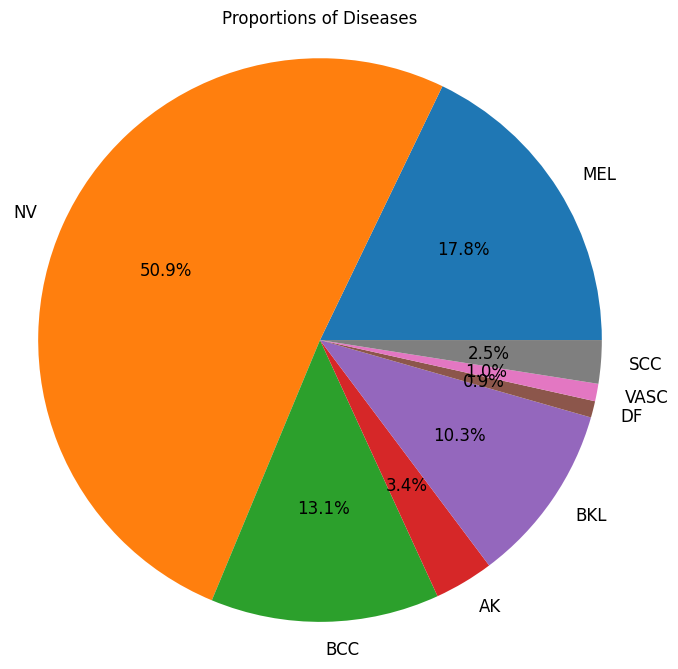

MEL      4512.0
NV      12864.0
BCC      3316.0
AK        859.0
BKL      2610.0
DF        239.0
VASC      253.0
SCC       628.0
dtype: float64


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Synoptic 2/Shuffled_Ground_Truth.csv')

disease_columns = df.columns[1:] #finding columns

disease_counts = df[disease_columns].sum() #find sum of instaces of each disease

#plotting the pie chart
plt.figure(figsize=(8, 8))
plt.pie(disease_counts, labels=disease_counts.index, autopct='%1.1f%%',textprops={'fontsize': 12})
plt.title('Proportions of Diseases')
plt.axis('equal')
plt.show()

print(disease_counts)

##Train Test Val balance + counts

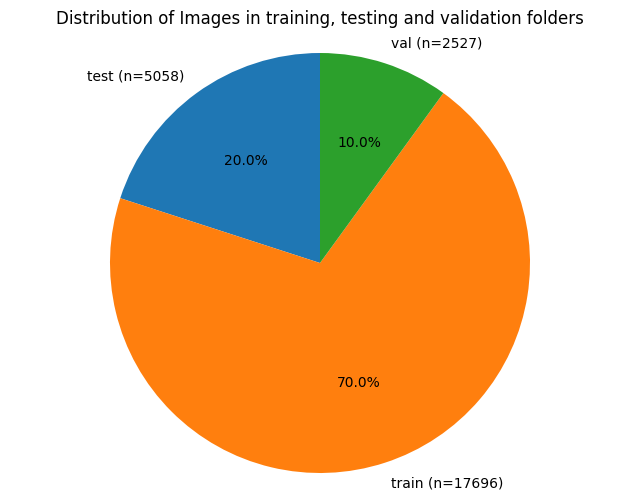

In [ ]:
subdirs = ['test', 'train', 'val'] #names of each folder, could have done a loop but there are only 3 so just did it like this

def total_files_in_directory(directory):  #counts total files in the directory
    total_count = 0
    for root, dirs, files in os.walk(directory): #for every sub directory
        total_count += len(files) #count files
    return total_count

def plot_overall_distribution(unzipped_path, subdirs):
    labels = []
    counts = []
    for subdir in subdirs:
        path = os.path.join(unzipped_path, subdir)
        count = total_files_in_directory(path)
        counts.append(count)
        labels.append(f"{subdir} (n={count})")

    #pie chart plotting
    plt.figure(figsize=(8, 6))
    plt.pie(counts, labels=labels, autopct='%1.1f%%', startangle=90)
    plt.axis('equal')
    plt.title('Distribution of Images in training, testing and validation folders')
    #this_fig_save_location = os.path.join(save_plots_for_presentation_location, "TrainTestValSplit")
    #plt.savefig(this_fig_save_location)
    plt.show()

plot_overall_distribution(unzipped_path, subdirs) #specifying what folder to count - done because could have been 'smaller_unzipped_path'

##Examples of each class

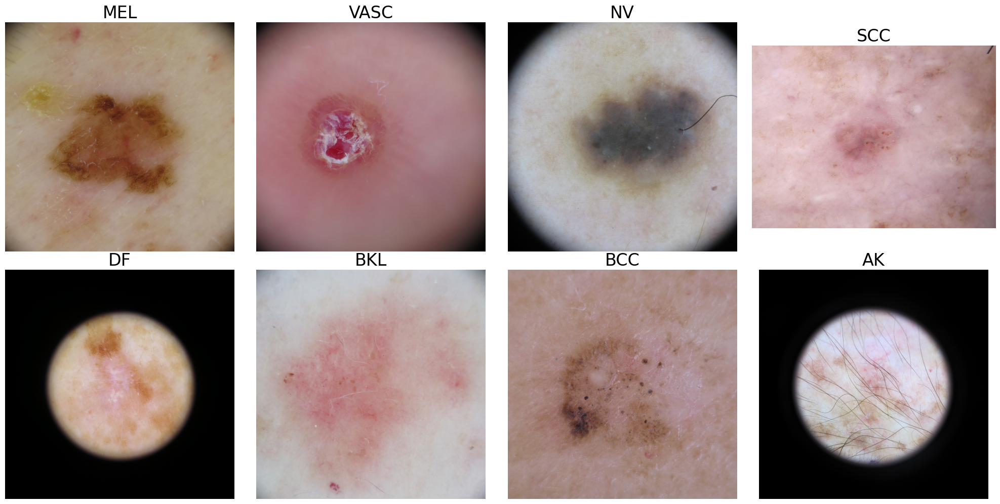

In [ ]:
training_dir = os.path.join(unzipped_path, 'train') #path to folder - doesnt matter that its training folder. Just chose any one.

class_dirs = [d for d in os.listdir(training_dir) if os.path.isdir(os.path.join(training_dir, d))] #finding names of each class in folder

num_classes = len(class_dirs)  #setting up to display images
cols = 4
rows = 2 #8 classes -> 4 columns, 2 rows
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(5 * cols, 5 * rows))
axes = axes.ravel()


for i, class_dir in enumerate(class_dirs): #displays one image from each class directory
    class_path = os.path.join(training_dir, class_dir)
    files = [os.path.join(class_path, f) for f in os.listdir(class_path) if not f.startswith('.')]
    img = Image.open(files[1]) #change this number to change the images being shown. Some are a bit much.
    axes[i].imshow(img)
    axes[i].set_title(class_dir, fontsize=24)
    axes[i].set_axis_off()

plt.tight_layout()
#this_fig_save_location = os.path.join(save_plots_for_presentation_location, "ExamplesOfClasses")
#plt.savefig(this_fig_save_location)
plt.show()


#**Dataset visualisation backup** - load imgs from files

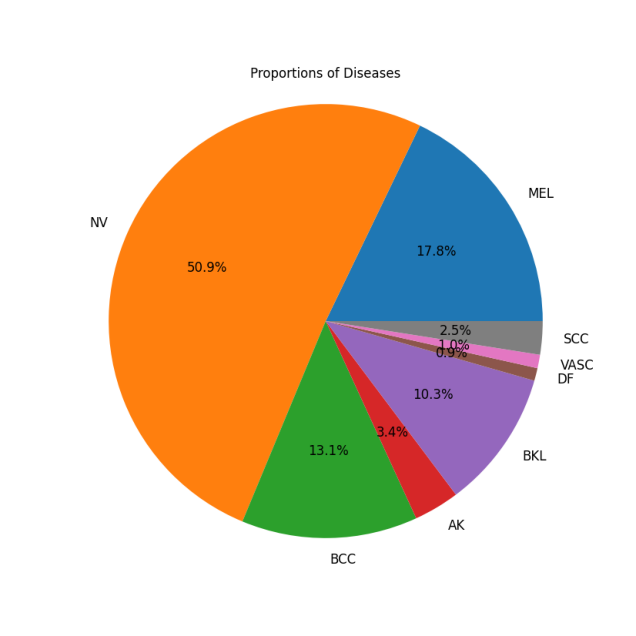

In [ ]:
class_imbalance_pie_chart = os.path.join(save_plots_for_presentation_location, 'ClassBalanceProportion.png')
img = Image.open(class_imbalance_pie_chart)
fig, ax = plt.subplots(figsize=(10, 8))

ax.imshow(img)
ax.axis('off')

plt.show()

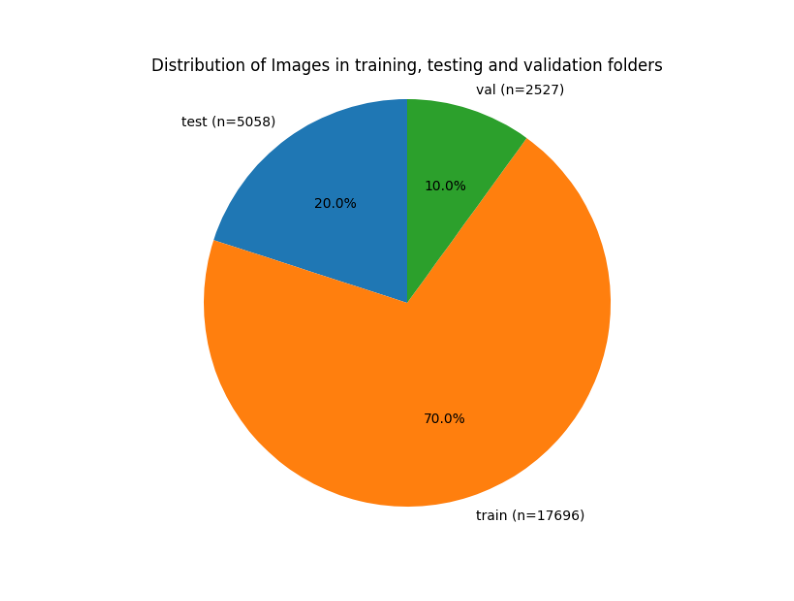

In [ ]:
TrainTestValSplit = os.path.join(save_plots_for_presentation_location, 'TrainTestValSplit.png')
img = Image.open(TrainTestValSplit)
fig, ax = plt.subplots(figsize=(10, 8))

ax.imshow(img)
ax.axis('off')

plt.show()

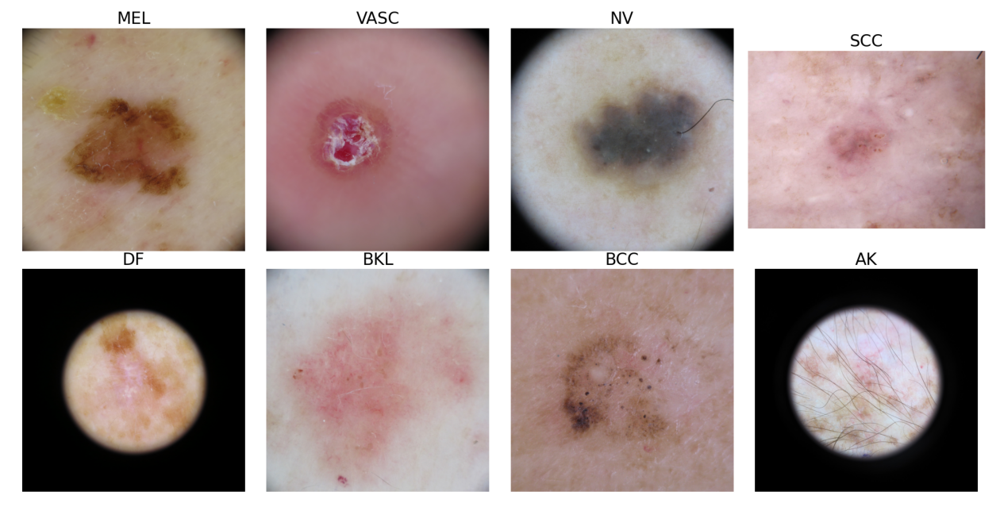

In [ ]:
ExamplesOfClasses = os.path.join(save_plots_for_presentation_location, 'ExamplesOfClasses.png')
img = Image.open(ExamplesOfClasses)
fig, ax = plt.subplots(figsize=(16,16))

ax.imshow(img)
ax.axis('off')

plt.show()

#CNN architecture setup


##function to initialise model as ResNet50

In [ ]:
def initialize_model_ResNet():

    model_name = "ResNet50"

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    device #setting device as cuda

    model = models.resnet50(pretrained=True).to(device) #download model

    for param in model.parameters():
      param.requires_grad = True

    model.fc = nn.Sequential( #fully connected layer
        nn.Dropout(0.5),
        nn.Linear(2048, 256), #2048 input features reduced to 256
        nn.ReLU(inplace=True),
        nn.Linear(256, 8)).to(device) #setting layers, there are 8 classes in the dataset

    criterion = nn.CrossEntropyLoss() #setting criterion

    #stochastic gradient descent |/- with momentum set to 0.9
    optimizer = optim.SGD(model.fc.parameters(), lr=initLR, momentum=0.9)

    #ReduceLROnPlateau for learning rate scheduling
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=LRDecayFactor, patience=LRDecayPatience)

    return model, device, model.fc, criterion, optimizer, scheduler, model_name


##function to initialise model as DenseNet121

In [ ]:
def initialize_model_DenseNet(): #setup is the same as ResNet50, except layer configuration

    model_name = "DenseNet121"

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    model = models.densenet121(pretrained=True).to(device)

    for param in model.parameters():
        param.requires_grad = True

    model.classifier = nn.Sequential( #classifier
        nn.Dropout(0.5),
        nn.Linear(1024, 256), #1024 input features reduced to 256
        nn.ReLU(inplace=True),
        nn.Linear(256, 8)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    optimizer = optim.SGD(model.classifier.parameters(), lr=initLR, momentum=0.9)

    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=LRDecayFactor, patience=LRDecayPatience)

    return model, device, model.classifier, criterion, optimizer, scheduler, model_name


#Define training method

In [ ]:
def train_model(model, criterion, optimizer, num_epochs, early_stopping_patience = earlyStopPatience): #standard training loop
    train_losses = []
    train_accs = []
    val_losses = []
    val_accs = []

    best_val_loss = float('inf')
    epochs_no_improve = 0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch + 1, num_epochs))
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                loss = criterion(outputs, labels)

                if phase == 'train':
                    optimizer.zero_grad()
                    loss.backward()
                    optimizer.step()

                _, preds = torch.max(outputs, 1)
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(image_datasets[phase])
            epoch_acc = running_corrects.double() / len(image_datasets[phase])

            if phase == 'train':
                train_losses.append(epoch_loss)
                train_accs.append(epoch_acc)
            else:
                val_losses.append(epoch_loss)
                val_accs.append(epoch_acc)

                if epoch_loss < best_val_loss:
                    best_val_loss = epoch_loss
                    epochs_no_improve = 0
                else:
                    epochs_no_improve += 1

            scheduler.step(epoch_loss)

            print('{} loss: {:.4f}, acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))


        if epochs_no_improve == early_stopping_patience: #stops training if validation loss doesnt improve for x num epochs
          print("Early stopping triggered")
          break

    return model, train_losses, train_accs, val_losses, val_accs


#Basic data augmentation

##Creating arrays of basic data augmentation techniques

transformations that must be applied to image data before it is turned into a tensor

In [ ]:
transformationsBeforeTensor = [
    transforms.RandomHorizontalFlip(p=1.0),  #flipping
    transforms.RandomRotation(degrees=180),  #rotation
    transforms.RandomResizedCrop(size=(224, 224), scale=(0.08, 1.0), ratio=(0.75, 1.333)),  #cropping
    transforms.RandomAffine(degrees=0, translate=(0.2, 0.2)),  #translation
    transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.5),  #color Changes
    transforms.GaussianBlur(kernel_size=9, sigma=(3.0, 7.0)), #gaussian Blurring
    transforms.RandomPerspective(distortion_scale=0.5, p=1.0)#perspective Transformation
    ]


should be in 'transformationsBeforeTensor[ ]' but it uses the same transforms.function as cropping so it is separated so the results do not get mixed up

In [ ]:
transformationScaling = [
    transforms.RandomResizedCrop(size=(224, 224), scale=(0.5, 1.5)) #scaling
]

transformations that must be applied to image data before it is turned into a tensor

In [ ]:
transformationsAfterTensor = [
    transforms.Lambda(lambda x: x + torch.randn_like(x) * 0.75), #noise injection
    transforms.RandomErasing(p=1, scale=(0.02, 0.33), ratio=(0.3, 3.3), value='random'),  #random Erasing
]


##Methods to apply basic data augmentation

function to apply transformations before turning data to tensor

In [ ]:
def augmentDataBeforeTensor(transformation_type):

    #apply data augmentation to the train data loader directly
    data_transforms['train'] = transforms.Compose([
        transforms.Resize((224,224)),
        transformation_type,  #apply the current transformation
        transforms.ToTensor(), #then turn to tensor
        normalize
    ])

    #update train data loader with the augmented transformations
    image_datasets['train'] = datasets.ImageFolder(os.path.join(currentDataset, 'train'), data_transforms['train'])
    dataloaders['train'] = torch.utils.data.DataLoader(image_datasets['train'],
                                                       batch_size=32,
                                                       shuffle=True,
                                                       num_workers=0)
    return image_datasets['train'], dataloaders['train']

function to apply transformations after turning data to tensor

In [ ]:
def augmentDataAfterTensor(transformation_type):

    #apply data augmentation to the train data loader directly
    data_transforms['train'] = transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(), #turn to tensor
        transformation_type,  #then apply the current transformation
        normalize
    ])

    #update train data loader with the augmented transformations
    image_datasets['train'] = datasets.ImageFolder(os.path.join(currentDataset, 'train'), data_transforms['train'])
    dataloaders['train'] = torch.utils.data.DataLoader(image_datasets['train'],
                                                       batch_size=32,
                                                       shuffle=True,
                                                       num_workers=0)
    return image_datasets['train'], dataloaders['train']

##Methods for visualising images augmented with basic techniques

function to denormalise so the image is recognisable

In [ ]:
def denormalize(tensor, mean, std):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor

function to save examples of the augmented images and their originals to file

In [ ]:
def visualize_augmented_data(dataset, transformation, base_directory, transformation_name, mean, std):
    #create a directory to save the augmented images
    transformation_directory = os.path.join(base_directory, transformation_name, 'augmented_data')
    os.makedirs(transformation_directory, exist_ok=True)

    #take a few samples from the dataset
    samples = [dataset[i] for i in range(10)]  #the number of samples to generate

    for i, (image, label) in enumerate(samples):
        #apply the transformation to the image
        transformed_image = transformation(image)

        #denormalize the images so they look normal
        original_image = denormalize(image.clone(), mean, std)
        transformed_image = denormalize(transformed_image.clone(), mean, std)

        #convert tensors to PIL images
        original_image_pil = F.to_pil_image(original_image)
        transformed_image_pil = F.to_pil_image(transformed_image)

        #creating file locations
        original_image_path = os.path.join(transformation_directory, f'{i}_original.jpg')
        transformed_image_path = os.path.join(transformation_directory, f'{i}_transformed.jpg')

        #save the original and transformed images
        original_image_pil.save(original_image_path)
        transformed_image_pil.save(transformed_image_path)

#**Basic Data Augmentations visualisation**..

##Setup

In [ ]:
plot_names = {}
plot_names["RandomHorizontalFlip"] = "Horizontal Flip"
plot_names["RandomRotation"] = "Rotation"
plot_names["RandomResizedCrop"] = "Cropping"
plot_names["RandomAffine"] = "Translation"
plot_names["ColorJitter"] = "Colour Change"
plot_names["GaussianBlur"] = "Gaussian Blurring"
plot_names["RandomPerspective"] = "Perspective Change"
plot_names["Scaling"] = "Scaling"
plot_names["Lambda"] = "Noise Injection"
plot_names["RandomErasing"] = "Random Erasing"
plot_names["No_augmentation"] = "No Augmentation"


main_images_path = os.path.join(data_and_graphs_path, 'Results/ResNet50')



In [ ]:
"""All augmentations save examples in a folder called 'augmented_data' in the form of x_original and x_transformed."""
image_paths = {}
image_paths[plot_names["No_augmentation"]] = os.path.join(data_and_graphs_path, 'Results/ResNet50/RandomHorizontalFlip/augmented_data/0_original.jpg') #doesnt matter its in the random flip folder as its the original
for subdir in os.listdir(main_images_path):
  if subdir != 'GANs' and subdir != 'No_augmentation':
    subdir_path = os.path.join(main_images_path, subdir)
    image_path = os.path.join(subdir_path, 'augmented_data/0_transformed.jpg') #all choosing the same image after augmentation
    image_paths[plot_names[subdir]] = image_path

##Plot to show examples of all basic augmentations

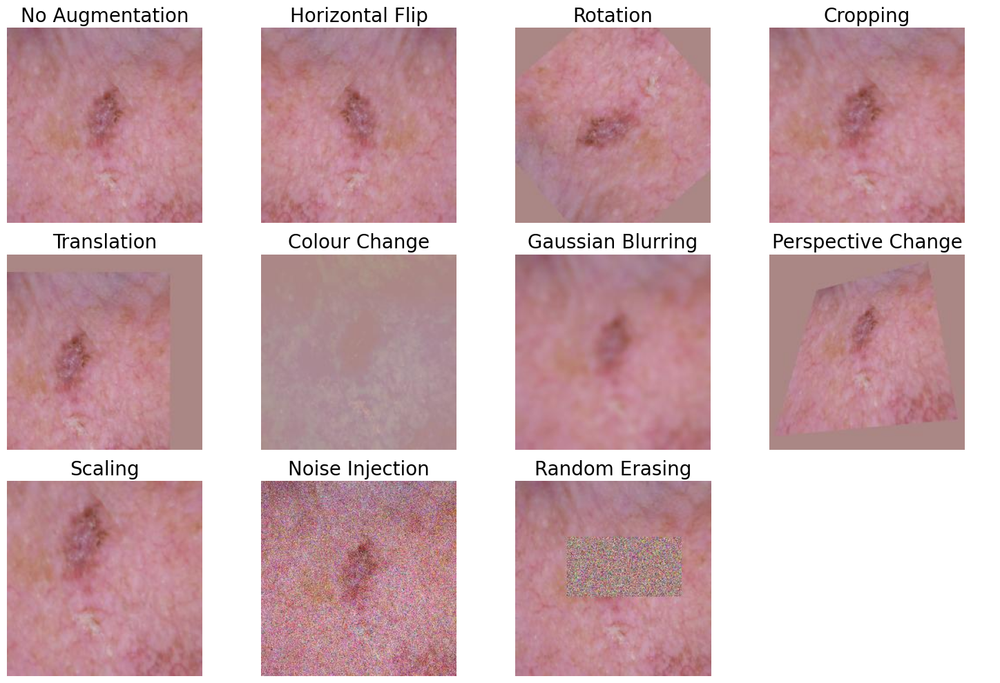

In [ ]:
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15, 10))
axes = axes.ravel()

for ax, (title, img_path) in zip(axes, image_paths.items()):
    if os.path.exists(img_path):
        img = Image.open(img_path)
        ax.imshow(img)
        ax.set_title(title, fontsize=20)
        ax.set_axis_off()

for ax in axes[len(image_paths):]:
    ax.set_axis_off()

plt.tight_layout()
#this_fig_save_location = os.path.join(save_plots_for_presentation_location, "ExamplesOfBasicAugs")
#plt.savefig(this_fig_save_location)
plt.show()

#**Basic augmentations visualisation backup**

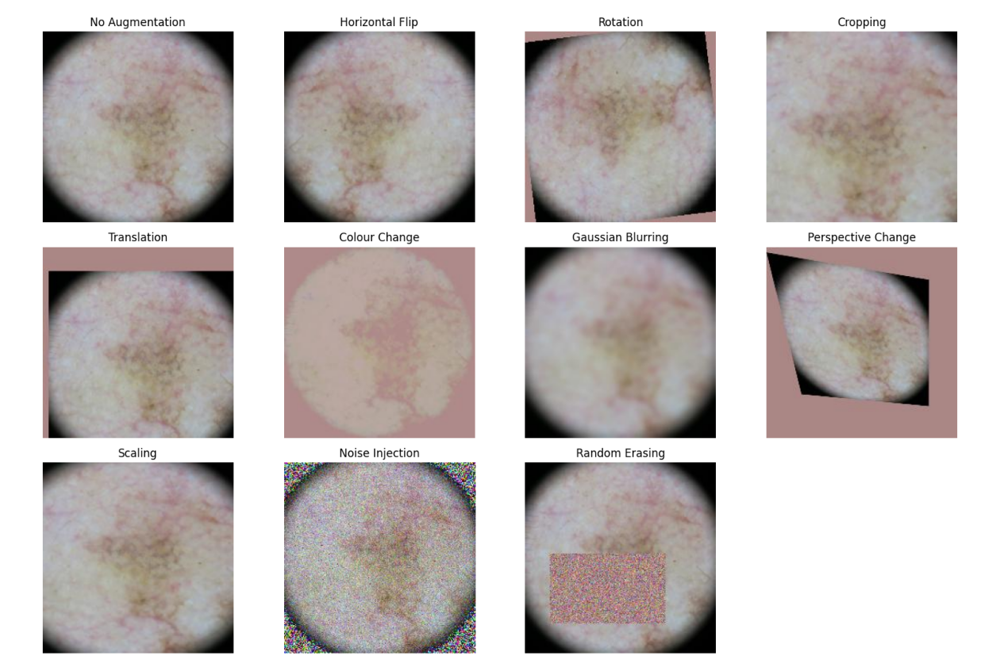

In [ ]:
ExamplesOfBasicAugs = os.path.join(save_plots_for_presentation_location, 'ExamplesOfBasicAugs.png')
img = Image.open(ExamplesOfBasicAugs)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

#GAN based data augmentation

The code used below to define and train the model is a slightly altered version of code taken from github.com available at https://github.com/KarthikNA/Image-Augmentation-using-GANs/blob/master/GANs%20-%20Complex%20Techniques/implementations/cgan/cgan.py The code from github is from cells 'setting device and place to store generated images' to 'training the gan'

##setting device and place to store generated images

In [ ]:
GANsFolder = os.path.join(data_and_graphs_path, 'GANs')
os.makedirs(GANsFolder, exist_ok=True)

##Detailed hyperparams

In [ ]:
class Args:
    n_epochs = GAN_epochs
    batch_size = GAN_batch_size
    lr = 0.0002
    b1 = 0.5
    b2 = 0.999
    n_cpu = 8
    latent_dim = 100
    n_classes = 8
    img_size = 224
    channels = 3
    sample_interval = GAN_sample_interval

opt = Args()
img_shape = (opt.channels, opt.img_size, opt.img_size)
cuda = True if torch.cuda.is_available() else False

##Defining the generator

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.label_emb = nn.Embedding(opt.n_classes, opt.n_classes)

        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(opt.latent_dim + opt.n_classes, 128, normalize=False),
            *block(128, 256),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, int(np.prod(img_shape))),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        # Concatenate label embedding and image to produce input
        gen_input = torch.cat((self.label_emb(labels), noise), -1)
        img = self.model(gen_input)
        img = img.view(img.size(0), *img_shape)
        return img



##Defining the discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.label_embedding = nn.Embedding(opt.n_classes, opt.n_classes)

        self.model = nn.Sequential(
            nn.Linear(opt.n_classes + int(np.prod(img_shape)), 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1),
        )

    def forward(self, img, labels):
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1), self.label_embedding(labels)), -1)
        validity = self.model(d_in)
        return validity

##Admin

In [ ]:
adversarial_loss = torch.nn.MSELoss() #loss functions

generator = Generator()
discriminator = Discriminator() #initialise generator and discriminator

if cuda:
    generator.cuda()
    discriminator.cuda()
    adversarial_loss.cuda()

dataloader = dataloaders['train'] #configure data loader

optimizer_G = torch.optim.Adam(generator.parameters(), lr=opt.lr, betas=(opt.b1, opt.b2))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=opt.lr, betas=(opt.b1, opt.b2)) #optimisers

FloatTensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor
LongTensor = torch.cuda.LongTensor if cuda else torch.LongTensor

idx_to_class = {v: k for k, v in image_datasets['train'].class_to_idx.items()} #creating dictionary to turn class index to class name
print(idx_to_class) #debug

{0: 'AK', 1: 'BCC', 2: 'BKL', 3: 'DF', 4: 'MEL', 5: 'NV', 6: 'SCC', 7: 'VASC'}


##Training the GAN

In [ ]:
for epoch in range(opt.n_epochs):
    for i, (imgs, labels) in enumerate(dataloader):

        batch_size = imgs.shape[0]

        # Adversarial ground truths
        valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)
        fake = Variable(FloatTensor(batch_size, 1).fill_(0.0), requires_grad=False)

        # Configure input
        real_imgs = Variable(imgs.type(FloatTensor))
        labels = Variable(labels.type(LongTensor))

        # -----------------
        #  Train Generator
        # -----------------

        optimizer_G.zero_grad()

        # Sample noise and labels as generator input
        z = Variable(FloatTensor(np.random.normal(0, 1, (batch_size, opt.latent_dim))))
        gen_labels = Variable(LongTensor(np.random.randint(0, opt.n_classes, batch_size)))

        # Generate a batch of images
        gen_imgs = generator(z, gen_labels)

        # Loss measures generator's ability to fool the discriminator
        validity = discriminator(gen_imgs, gen_labels)
        g_loss = adversarial_loss(validity, valid)

        g_loss.backward()
        optimizer_G.step()


        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Loss for real images
        validity_real = discriminator(real_imgs, labels)
        d_real_loss = adversarial_loss(validity_real, valid)

        # Loss for fake images
        validity_fake = discriminator(gen_imgs.detach(), gen_labels)
        d_fake_loss = adversarial_loss(validity_fake, fake)

        # Total discriminator loss
        d_loss = (d_real_loss + d_fake_loss) / 2

        d_loss.backward()
        optimizer_D.step()

        print(
            "[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"
            % (epoch, opt.n_epochs, i, len(dataloader), d_loss.item(), g_loss.item())
        )

        batches_done = epoch * len(dataloader) + i
        if batches_done % opt.sample_interval == 0:
            for label in gen_labels.unique():
              class_name = idx_to_class[label.item()]
              dir_path = os.path.join(GANsFolder, class_name)
              os.makedirs(dir_path, exist_ok=True)

              for i, (img, label) in enumerate(zip(gen_imgs.data, gen_labels)):
                  class_name = idx_to_class[label.item()]
                  dir_path = os.path.join(GANsFolder, class_name)
                  os.makedirs(dir_path, exist_ok=True)
                  image_name = f"{batches_done}_{i}.png"
                  save_path = os.path.join(dir_path, image_name)
                  save_image(img, save_path, normalize=True)


<ipython-input-25-0f16be4b9498>:7: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:83.)
  valid = Variable(FloatTensor(batch_size, 1).fill_(1.0), requires_grad=False)


[Epoch 0/2] [Batch 0/28] [D loss: 0.493997] [G loss: 0.962873]
[Epoch 0/2] [Batch 1/28] [D loss: 16.640121] [G loss: 0.902916]
[Epoch 0/2] [Batch 2/28] [D loss: 23.747763] [G loss: 0.874861]
[Epoch 0/2] [Batch 3/28] [D loss: 88.382683] [G loss: 0.835479]
[Epoch 0/2] [Batch 4/28] [D loss: 29.864429] [G loss: 0.818072]
[Epoch 0/2] [Batch 5/28] [D loss: 25.543762] [G loss: 0.775189]
[Epoch 0/2] [Batch 6/28] [D loss: 15.388845] [G loss: 0.737010]
[Epoch 0/2] [Batch 7/28] [D loss: 31.255600] [G loss: 0.665446]
[Epoch 0/2] [Batch 8/28] [D loss: 81.442024] [G loss: 0.643183]
[Epoch 0/2] [Batch 9/28] [D loss: 5.412538] [G loss: 0.584523]
[Epoch 0/2] [Batch 10/28] [D loss: 39.302238] [G loss: 0.525387]
[Epoch 0/2] [Batch 11/28] [D loss: 6.255044] [G loss: 0.519562]
[Epoch 0/2] [Batch 12/28] [D loss: 6.257204] [G loss: 0.458039]
[Epoch 0/2] [Batch 13/28] [D loss: 85.889191] [G loss: 0.376402]
[Epoch 0/2] [Batch 14/28] [D loss: 38.275658] [G loss: 0.357403]
[Epoch 0/2] [Batch 15/28] [D loss: 4.24

##Working out how many images each class to generate

In [ ]:
train_directory = os.path.join(currentDataset, 'train')
class_index_to_file_count = {}

for class_name, class_idx in image_datasets['train'].class_to_idx.items():
    #counts the num of images in each class
    class_dir_path = os.path.join(train_directory, class_name)
    num_files = len([entry for entry in os.listdir(class_dir_path) if os.path.isfile(os.path.join(class_dir_path, entry))])
    #joins the count for each class to the class index
    class_index_to_file_count[class_idx] = num_files

print(class_index_to_file_count) #debud

{0: 30, 1: 116, 2: 91, 3: 8, 4: 157, 5: 450, 6: 22, 7: 8}


##Generating images

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.eval()

GeneratedImgsFolder = os.path.join(GANsFolder, "Generated_imgs")
os.makedirs(GeneratedImgsFolder, exist_ok=True)

batch_size = GAN_GeneratingIMGs_BatchSize

#loop through each class
for class_id in range(opt.n_classes):
    num_images_per_class = class_index_to_file_count[class_id]
    class_name = idx_to_class[class_id]
    dir_path = os.path.join(GeneratedImgsFolder, class_name)
    os.makedirs(dir_path, exist_ok=True)

    i = 0
    while i < num_images_per_class:
        #determine num of images to process in this batch
        batch_end = min(i + batch_size, num_images_per_class)
        actual_batch_size = batch_end - i

        if actual_batch_size <= 0:
            break

        labels = torch.full((actual_batch_size,), class_id, dtype=torch.long, device=device) #generate labels for this batch

        noise = torch.randn(actual_batch_size, opt.latent_dim, device=device) #generate noise for the generator

        with torch.no_grad():
            generated_images = generator(noise, labels).detach().cpu()  #generate images with no gradient calculation

        #save each generated image
        for image_number, image in enumerate(generated_images, start=i):
            image_name = f"{class_name}_{image_number}.png"
            save_path = os.path.join(dir_path, image_name)
            save_image(image, save_path, normalize=True)

        print(f"Generated images for class {class_name} from {i} to {batch_end - 1}.") #print progress and update i for next batch start
        i = batch_end  # update i for next batch


Generated images for class AK from 0 to 29.
Generated images for class BCC from 0 to 115.
Generated images for class BKL from 0 to 90.
Generated images for class DF from 0 to 7.
Generated images for class MEL from 0 to 127.
Generated images for class MEL from 128 to 156.
Generated images for class NV from 0 to 127.
Generated images for class NV from 128 to 255.
Generated images for class NV from 256 to 383.
Generated images for class NV from 384 to 449.
Generated images for class SCC from 0 to 21.
Generated images for class VASC from 0 to 7.


##Creating a dataset of the original images plus the generated images

In [ ]:
GANsDataset = os.path.join(temporary_storage_path, "/Datasets/GANsDataset") #create a new dataset while running (technically temporary)
os.makedirs(GANsDataset, exist_ok=True)

originalDataset = os.path.join(currentDataset, 'train') #getting original training set

def copy_to_temp(source_folder, temp_folder):
    subdirs = os.listdir(source_folder)
    for subdir in subdirs: #for each subdirectory (class)
        source_dir = os.path.join(source_folder, subdir)
        temp_dir = os.path.join(temp_folder, subdir) #get path to the class from the source and path to class for the temp

        if not os.path.exists(temp_dir):
            os.makedirs(temp_dir) #create the temp directory for class if it doesnt exist

        files = os.listdir(source_dir) #get all the files from the original source

        for file in files:
            source_file = os.path.join(source_dir, file)# get file name of original image
            temp_file = os.path.join(temp_dir, file) #get the file name to be saved in new temp dataset

            shutil.copy(source_file, temp_file) #copy original for temp

copy_to_temp(originalDataset, GANsDataset) #copys all original train data to new dataset
copy_to_temp(GeneratedImgsFolder, GANsDataset) #copys all generated data to new dataset

print("folders combined")


folders combined


##verifying the correct number of images are in each folder

In [ ]:
#just counts the files in original dataset and new temporaryu dataset. Temp should have double the amount of files for each class

def count_files_in_folders(directory):

    for item in os.listdir(directory):
        item_path = os.path.join(directory, item)

        if os.path.isdir(item_path):

            files = [f for f in os.listdir(item_path) if os.path.isfile(os.path.join(item_path, f))]

            print(f"Folder '{item}' contains {len(files)} files.")

count_files_in_folders(originalDataset)
count_files_in_folders(GANsDataset)


Folder 'SCC' contains 22 files.
Folder 'BCC' contains 116 files.
Folder 'MEL' contains 157 files.
Folder 'NV' contains 450 files.
Folder 'DF' contains 8 files.
Folder 'AK' contains 30 files.
Folder 'VASC' contains 8 files.
Folder 'BKL' contains 91 files.
Folder 'SCC' contains 44 files.
Folder 'BCC' contains 232 files.
Folder 'MEL' contains 314 files.
Folder 'NV' contains 900 files.
Folder 'DF' contains 16 files.
Folder 'AK' contains 60 files.
Folder 'VASC' contains 16 files.
Folder 'BKL' contains 182 files.


##Data loading for GANs dataset

In [ ]:
#basically the same as the regular data load but with the merged dataset
def GANsDataLoad():
    data_transforms['train'] = transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        normalize
    ])

    #update train data loader with the augmented transformations
    image_datasets['train'] = datasets.ImageFolder(GANsDataset, data_transforms['train'])
    dataloaders['train'] = torch.utils.data.DataLoader(image_datasets['train'],
                                                       batch_size=32,
                                                       shuffle=True,
                                                       num_workers=0)
    return image_datasets['train'], dataloaders['train']

#**GAN images visualisation** ..

##file location of images

In [ ]:
main_images_path = os.path.join('/content/drive/MyDrive/Synoptic_Final/AdrianResults/myResults/GANs/SelectedGanImgs') #where all the selected GAN images are (couldn't upload whole folder, too big)

##100 epochs example

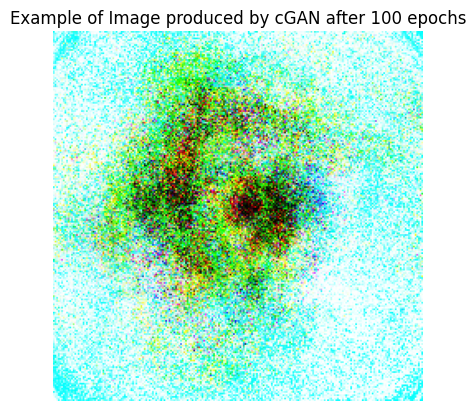

In [ ]:
one_MILLION_epochs = os.path.join(main_images_path, 'NVafter100.png')
img = Image.open(one_MILLION_epochs)
fig, ax = plt.subplots()

ax.imshow(img)
ax.set_title("Example of Image produced by cGAN after 100 epochs")
ax.axis('off')

plt.show()

##Image generation after x epochs

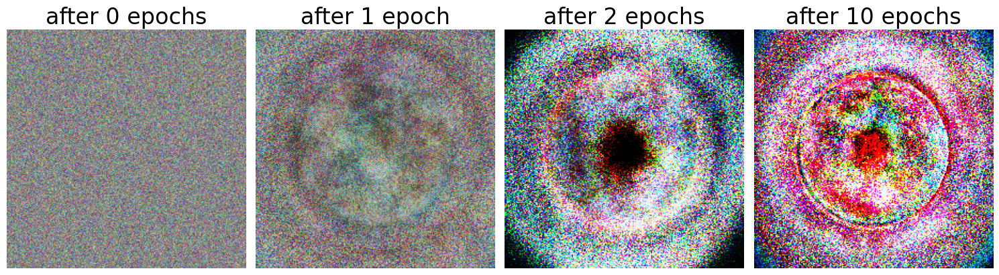

In [ ]:


image_paths = {}
image_paths['after 0 epochs'] = os.path.join(main_images_path, 'Generation/0_30.png')
image_paths['after 1 epoch'] = os.path.join(main_images_path, 'Generation/200_3.png')
image_paths['after 2 epochs'] = os.path.join(main_images_path, 'Generation/1200_10.png')
image_paths['after 10 epochs'] = os.path.join(main_images_path, 'Generation/5000_27.png')

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(15, 10))
axes = axes.ravel()

for ax, (title, img_path) in zip(axes, image_paths.items()): #iterating through images
    if os.path.exists(img_path):
        img = Image.open(img_path)
        ax.imshow(img)
        ax.set_title(title, fontsize=24)
        ax.set_axis_off()

for ax in axes[len(image_paths):]:
    ax.set_axis_off()

plt.tight_layout() #aesthetics
#this_fig_save_location = os.path.join(save_plots_for_presentation_location, "GANgenerationThroughoutEpochs")
#plt.savefig(this_fig_save_location)
plt.show()

##Examples of all classes generated by trained cGAN

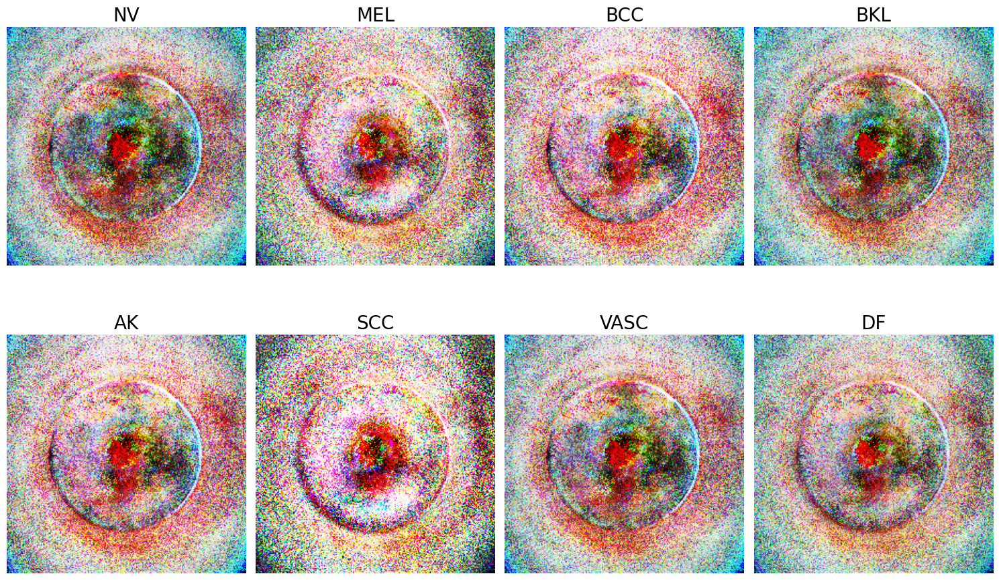

In [ ]:
#main_images_path = os.path.join(data_and_graphs_path, 'GANs/Generated_imgs')

image_paths = {}
image_paths['NV'] = os.path.join(main_images_path, 'NV/NV_144.png')
image_paths['MEL'] = os.path.join(main_images_path, 'MEL/MEL_99.png')
image_paths['BCC'] = os.path.join(main_images_path, 'BCC/BCC_5.png')
image_paths['BKL'] = os.path.join(main_images_path, 'BKL/BKL_8.png')
image_paths['AK'] = os.path.join(main_images_path, 'AK/AK_89.png')
image_paths['SCC'] = os.path.join(main_images_path, 'SCC/SCC_164.png')
image_paths['VASC'] = os.path.join(main_images_path, 'VASC/VASC_169.png')
image_paths['DF'] = os.path.join(main_images_path, 'DF/DF_20.png')

fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15, 10))
axes = axes.ravel()

for ax, (title, img_path) in zip(axes, image_paths.items()):
    if os.path.exists(img_path):
        img = Image.open(img_path)
        ax.imshow(img)
        ax.set_title(title, fontsize=20)
        ax.set_axis_off()

for ax in axes[len(image_paths):]:
    ax.set_axis_off()

plt.tight_layout()
#this_fig_save_location = os.path.join(save_plots_for_presentation_location, "ExamplesOfGANClasses")
#plt.savefig(this_fig_save_location)
plt.show()

#**GAN visualisation backup**

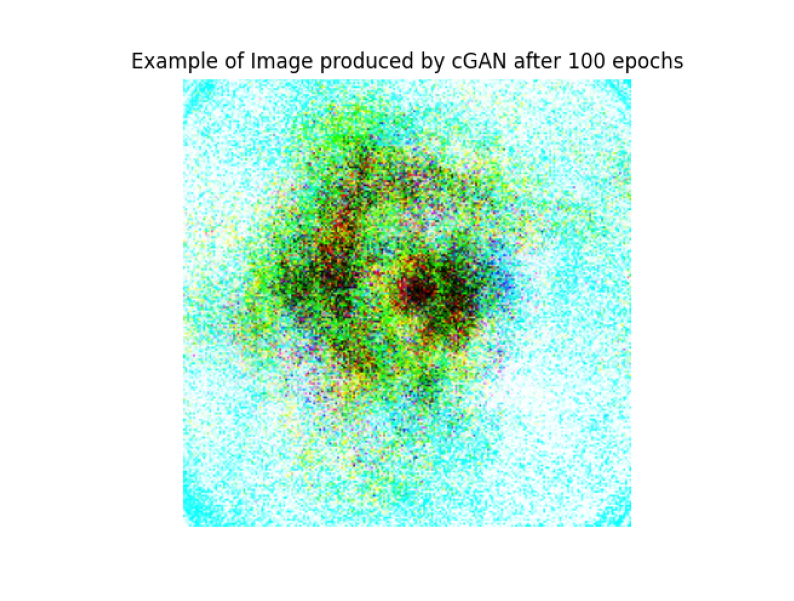

In [ ]:
ExampleOf100Epochs = os.path.join(save_plots_for_presentation_location, 'ExampleOf100Epochs.png')
img = Image.open(ExampleOf100Epochs)
fig, ax = plt.subplots(figsize=(10, 10))

ax.imshow(img)
ax.axis('off')

plt.show()

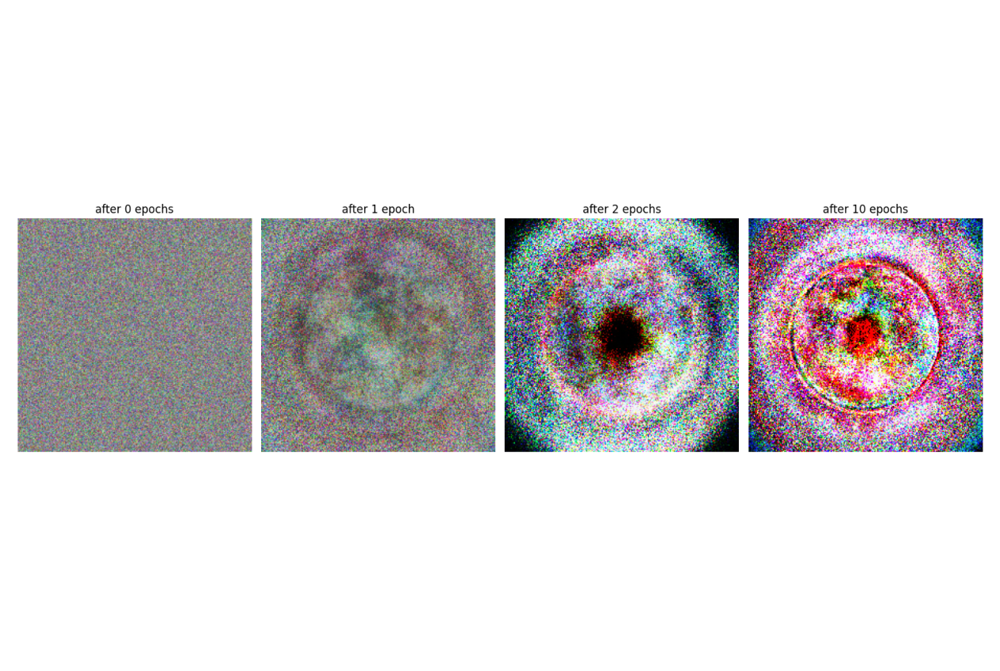

In [ ]:
GANgenerationThroughoutEpochs = os.path.join(save_plots_for_presentation_location, 'GANgenerationThroughoutEpochs.png')
img = Image.open(GANgenerationThroughoutEpochs)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

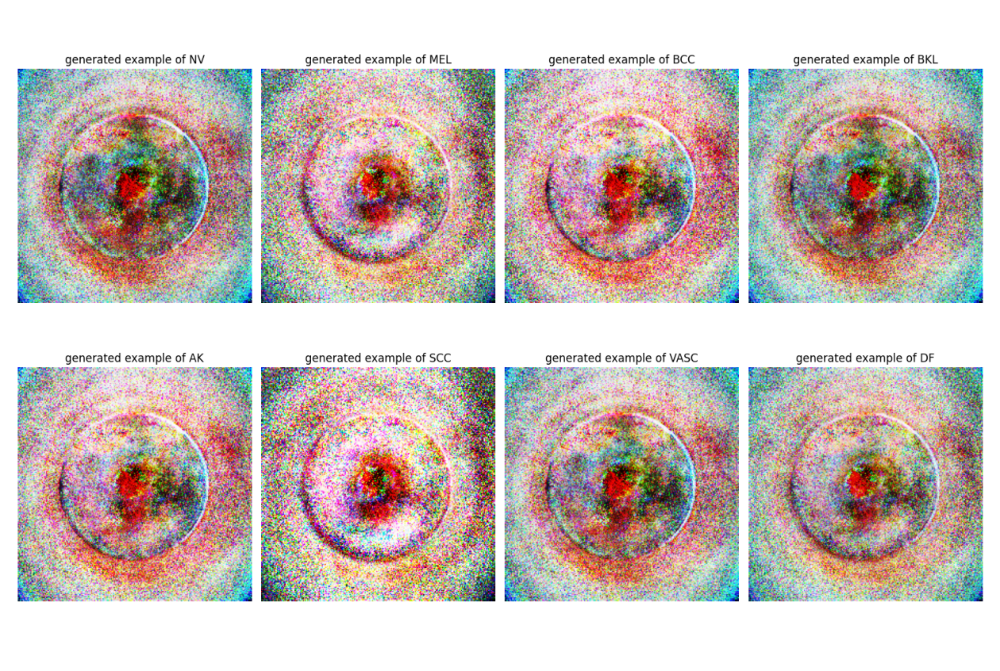

In [ ]:
ExamplesOfGANClasses = os.path.join(save_plots_for_presentation_location, 'ExamplesOfGANClasses.png')
img = Image.open(ExamplesOfGANClasses)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

#Define testing function / Functions for model evaluation

##Methods for plotting and saving graphs

###training and validation loss

In [ ]:
def plot_and_save_losses(train_losses, val_losses, base_directory, transformation_name, image_name):
  #creating the plot
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend() #calculates for the training and val loss plot

  #creating file location
    transformation_directory = os.path.join(base_directory, transformation_name)

    os.makedirs(transformation_directory, exist_ok=True)

    image_path = os.path.join(transformation_directory, image_name)

  #saving the plot
    plt.savefig(image_path) #saving the image in relavent folder

  #showing the plot
    plt.show() #show image

###ROC curves with AUC vals

In [ ]:
def plot_roc_curve_and_save(actuals, probs, base_directory, transformation_name, image_name):

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    one_hot_actuals = np.eye(8)[actuals.numpy()] #convert probabilities to one-hot encoded labels, ie converts categorical data into numerical by splitting columns - separates the classes as making multiple ROC curves

    for i in range(8):
        fpr[i], tpr[i], _ = roc_curve(one_hot_actuals[:, i], probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i]) #calculate fpr, tpr, and roc_auc for each class

    fpr["micro"], tpr["micro"], _ = roc_curve(one_hot_actuals.ravel(), probs.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"]) #calc micro-average ROC curve and ROC area - micro avg gives weights to classes so shows a better overall average

    plt.figure()
    plt.plot(fpr["micro"], tpr["micro"], color='deeppink', linestyle=':', linewidth=4, label='micro-average (AUC = %0.2f)' % roc_auc["micro"])
    for i in range(8):
        plt.plot(fpr[i], tpr[i], lw=2, label='Class %d (AUC = %0.2f)' % (i, roc_auc[i])) #ploting ROC curve

    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")

    transformation_directory = os.path.join(base_directory, transformation_name)
    os.makedirs(transformation_directory, exist_ok=True)
    image_path = os.path.join(transformation_directory, image_name)
    plt.savefig(image_path) #saving the curve to the relavent folder
    plt.show()

##Confusion matrix

In [ ]:
def plot_confusion_matrix_and_save(actuals, preds, base_directory, transformation_name, image_name):

    conf_mat = confusion_matrix(actuals.numpy(), preds.numpy())

    #display the confusion matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=conf_mat)
    disp.plot(cmap=plt.cm.Blues)

    transformation_directory = os.path.join(base_directory, transformation_name)
    os.makedirs(transformation_directory, exist_ok=True)
    image_path = os.path.join(transformation_directory, image_name)
    plt.savefig(image_path) #ssave to relavent folder

    plt.show()

##Overall model evaluation function

In [ ]:
def evaluate_model_and_save_results(model_trained, dataloaders, device, base_directory, transformation_name):

    evaluation_results = [] #array to store results

    predlist = torch.zeros(0, dtype=torch.long, device='cpu') #predcted labels
    lbllist = torch.zeros(0, dtype=torch.long, device='cpu') #true labels

    probs = torch.zeros(0, dtype=torch.float, device='cpu') #predicted probabilites
    actuals = torch.zeros(0, dtype=torch.long, device='cpu') #also stores true labels but is kept seperate to lbllist for debug

    with torch.no_grad():
        for inputs, labels in dataloaders['test']:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model_trained(inputs)

            _, preds = torch.max(outputs, 1)

            #append batch prediction results
            predlist = torch.cat([predlist, preds.view(-1).cpu()])
            lbllist = torch.cat([lbllist, labels.view(-1).cpu()])

            #apply softmax to get probabilities
            probs_batch = outputs.softmax(dim=1)  #probabilities for all classes
            probs = torch.cat([probs, probs_batch.cpu()])
            actuals = torch.cat([actuals, labels.cpu()])

    #calculate accuracy
    accuracy = (predlist == lbllist).float().mean().item()

    #calculate precision, recall, specificity, and F1 score
    precision = precision_score(lbllist.numpy(), predlist.numpy(), average='weighted')
    recall = recall_score(lbllist.numpy(), predlist.numpy(), average='weighted')

    #calculate F1 score
    f1 = f1_score(lbllist.numpy(), predlist.numpy(), average='weighted')

    #plotting and saving ROC and Confusion matrix
    plot_roc_curve_and_save(actuals, probs, base_directory, transformation_name, 'ROC_AUC.png')

    plot_confusion_matrix_and_save(actuals, predlist, base_directory, transformation_name, 'Conf_mat.png')

    #store evaluation results
    evaluation_results.append({
        'transformation': transformation_name,
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
    })

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1 Score:", f1)
    print("="*30) #this just separtes lines in the console for readability

    individual_field_names = ['transformation', 'accuracy', 'precision', 'recall', 'f1_score']

    individual_csv_folder_path = os.path.join(base_directory, transformation_name)
    individual_csv_file_path = os.path.join(individual_csv_folder_path, 'results.csv')

    with open(individual_csv_file_path, mode='w', newline='') as file:
      writer = csv.DictWriter(file, fieldnames=individual_field_names)
      writer.writeheader()
      for result in evaluation_results:
          writer.writerow(result) #saving the results to csv

#Model implementation

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 162MB/s]


ResNet reset
Training  ResNet50  with transformation: No_augmentation
Epoch 1/3
----------
train loss: 1.7316, acc: 0.4172
val loss: 1.4488, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4228, acc: 0.5125
val loss: 1.3730, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3729, acc: 0.5113
val loss: 1.3205, acc: 0.5242


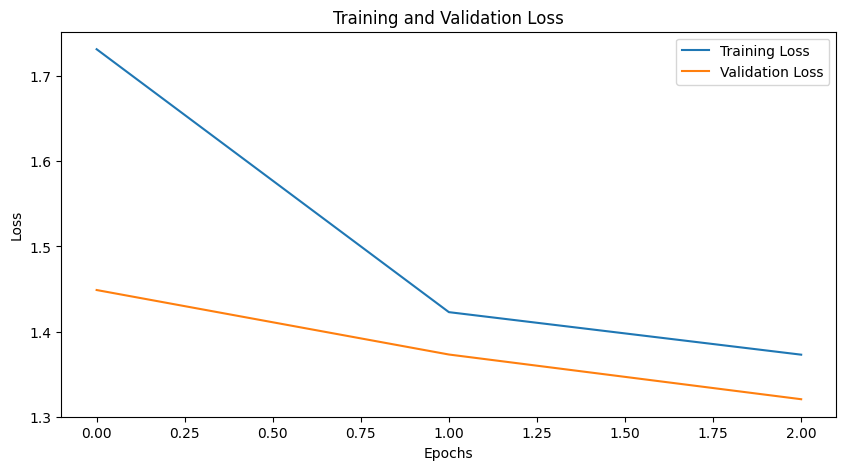

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


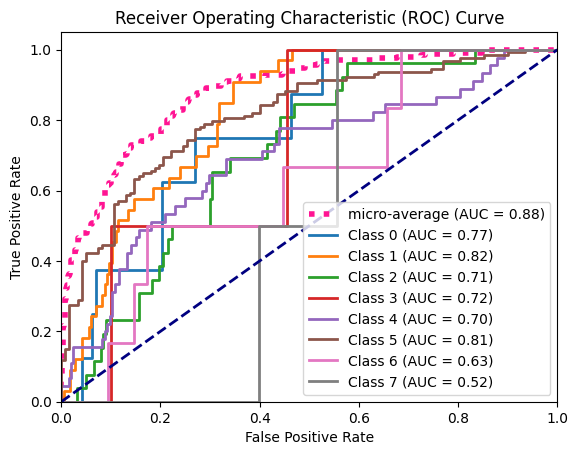

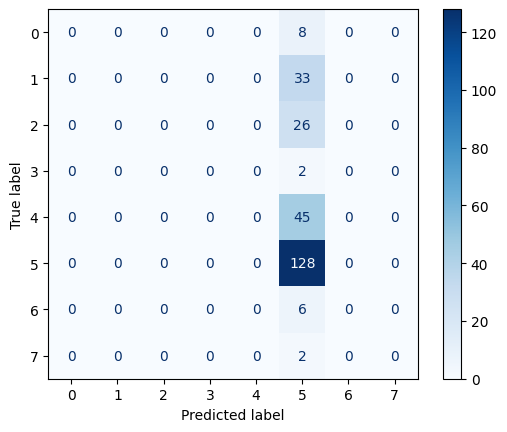

Accuracy: 0.5120000243186951
Precision: 0.262144
Recall: 0.512
F1 Score: 0.34675132275132275


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: GANs
Epoch 1/3
----------
train loss: 1.5958, acc: 0.4734
val loss: 1.4095, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4110, acc: 0.5108
val loss: 1.3264, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3694, acc: 0.5147
val loss: 1.2757, acc: 0.5161


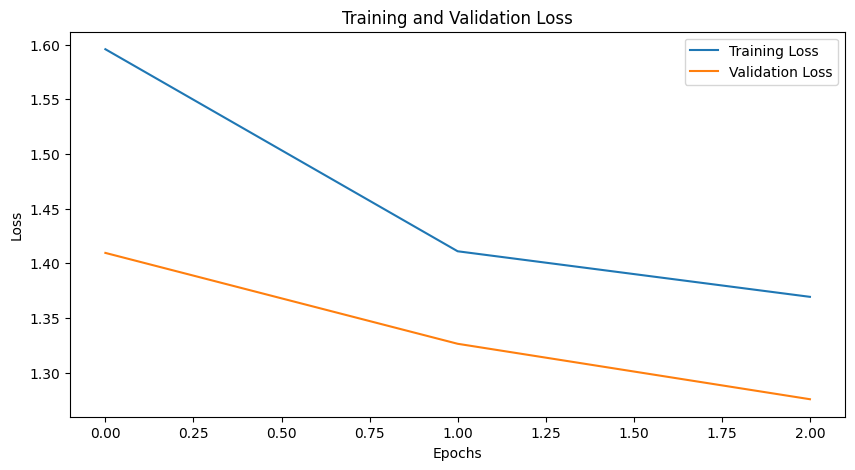

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


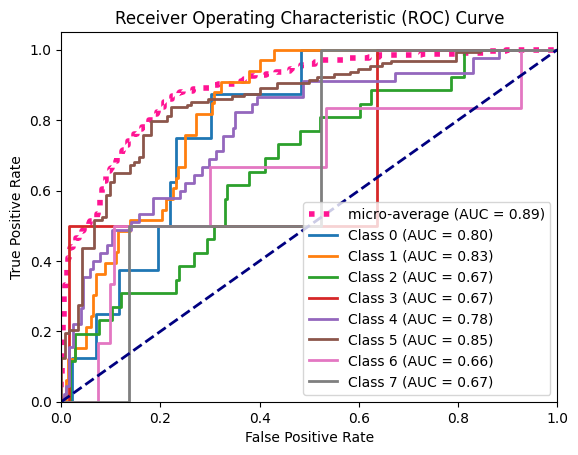

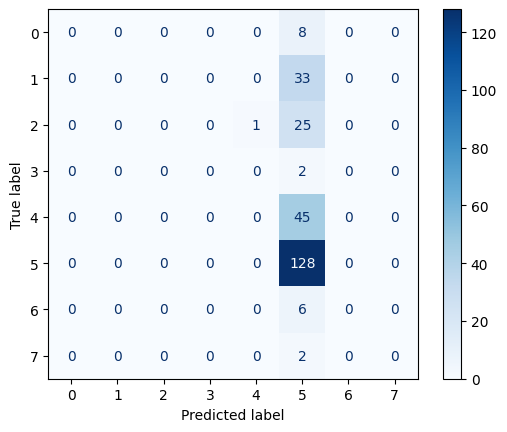

Accuracy: 0.5120000243186951
Precision: 0.26319678714859435
Recall: 0.512
F1 Score: 0.34767108753315645


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomHorizontalFlip
Epoch 1/3
----------
train loss: 1.6954, acc: 0.4376
val loss: 1.4932, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4263, acc: 0.5102
val loss: 1.3687, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3685, acc: 0.5147
val loss: 1.3187, acc: 0.5403


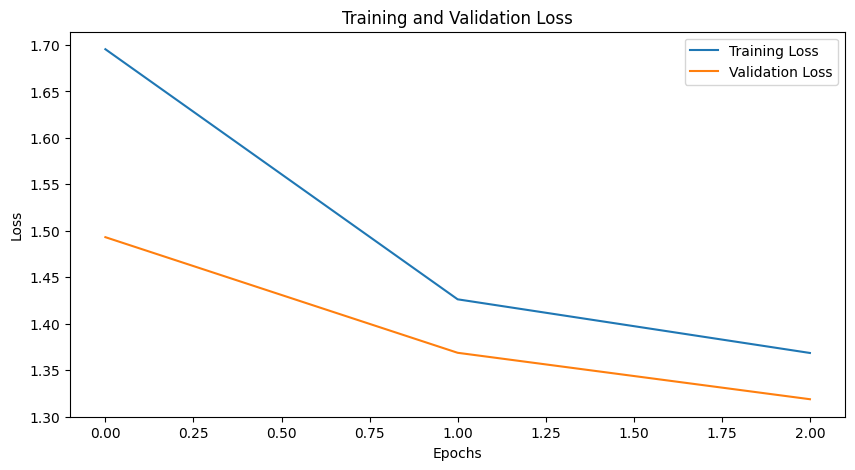

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


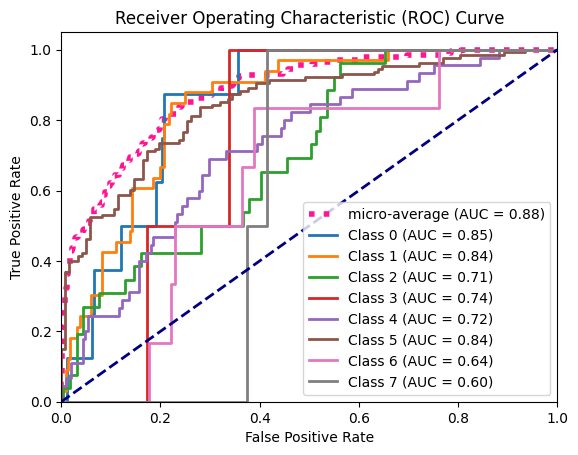

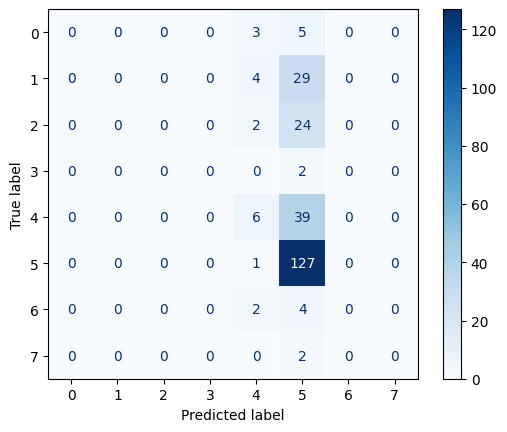

Accuracy: 0.5320000052452087
Precision: 0.34027586206896554
Recall: 0.532
F1 Score: 0.39553015873015873


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomRotation
Epoch 1/3
----------
train loss: 1.6614, acc: 0.4717
val loss: 1.4544, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4311, acc: 0.5102
val loss: 1.4156, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3836, acc: 0.5102
val loss: 1.3832, acc: 0.5242


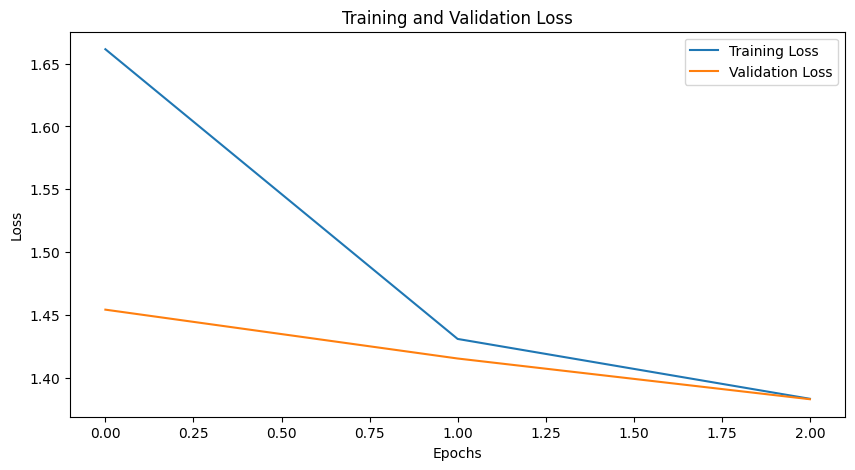

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


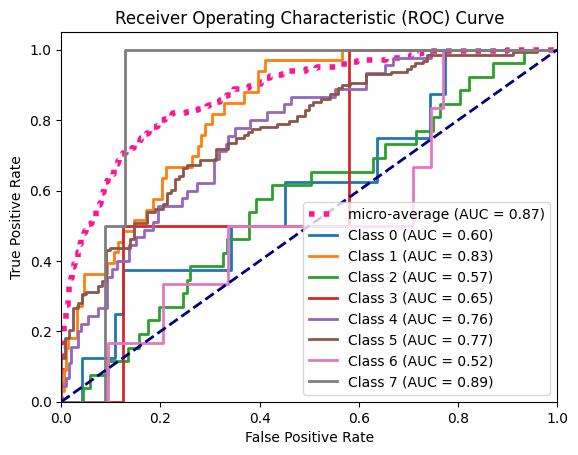

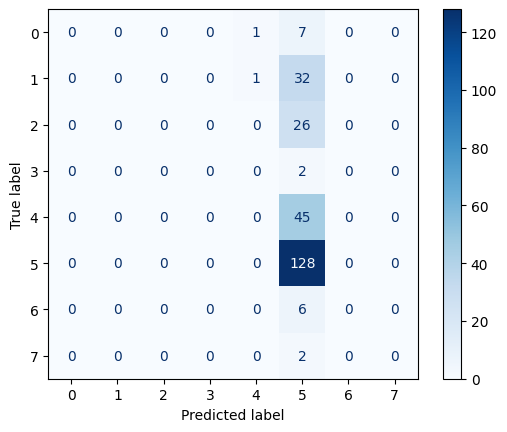

Accuracy: 0.5120000243186951
Precision: 0.26425806451612904
Recall: 0.512
F1 Score: 0.3485957446808511


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomResizedCrop
Epoch 1/3
----------
train loss: 1.7299, acc: 0.4365
val loss: 1.4787, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4394, acc: 0.5102
val loss: 1.4011, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3933, acc: 0.5102
val loss: 1.3464, acc: 0.5161


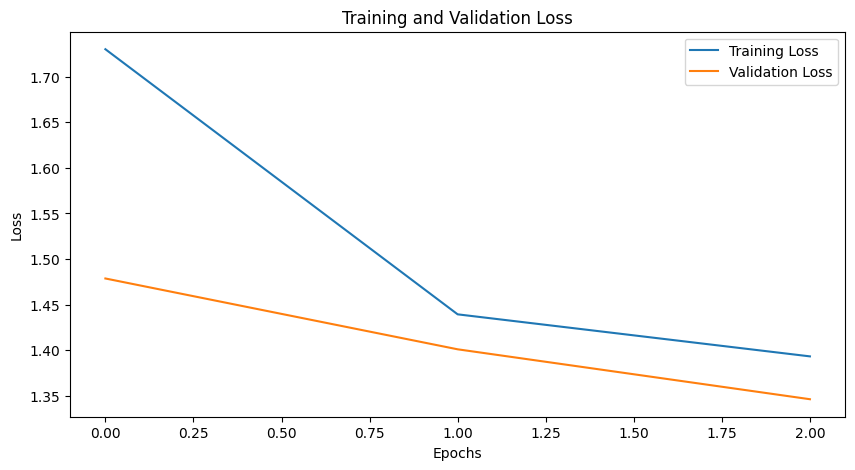

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


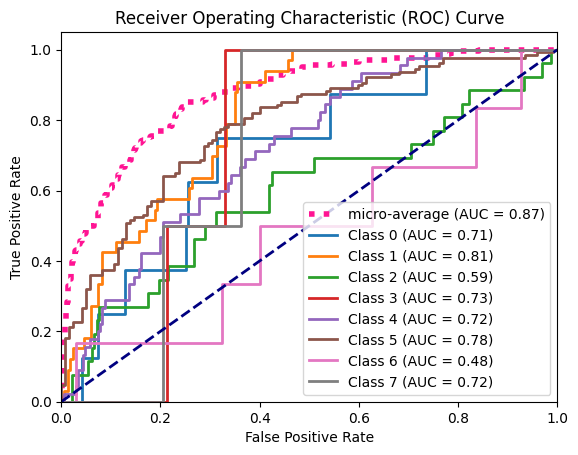

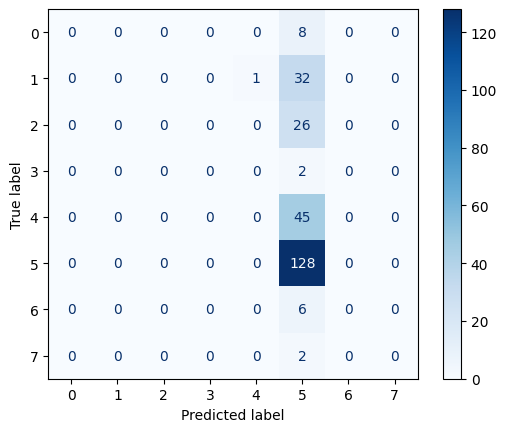

Accuracy: 0.5120000243186951
Precision: 0.26319678714859435
Recall: 0.512
F1 Score: 0.34767108753315645


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomAffine
Epoch 1/3
----------
train loss: 1.7309, acc: 0.4263
val loss: 1.4689, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4280, acc: 0.5102
val loss: 1.3823, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3908, acc: 0.5102
val loss: 1.3527, acc: 0.5242


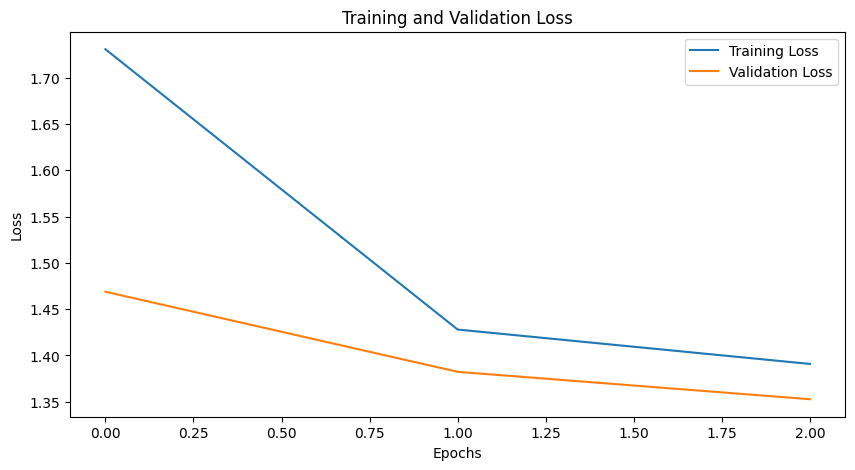

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


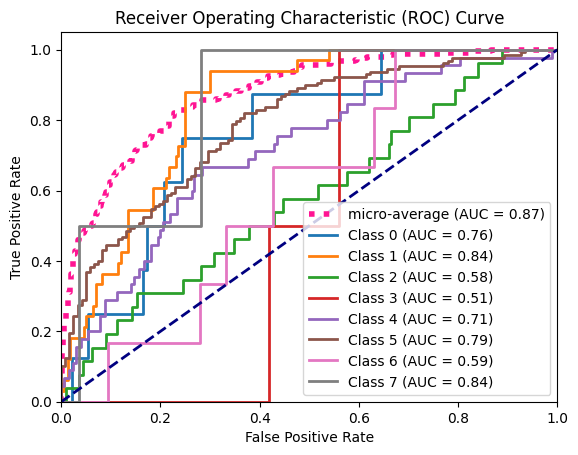

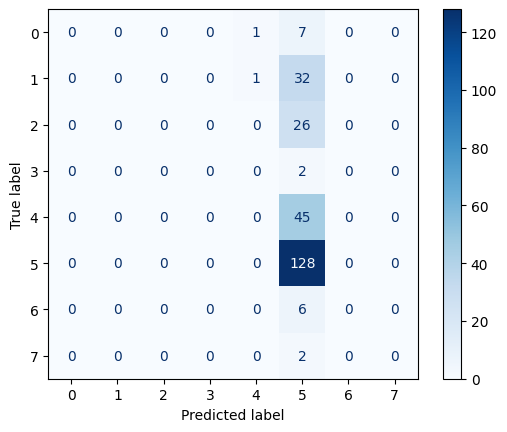

Accuracy: 0.5120000243186951
Precision: 0.26425806451612904
Recall: 0.512
F1 Score: 0.3485957446808511


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: ColorJitter
Epoch 1/3
----------
train loss: 1.7108, acc: 0.4569
val loss: 1.4540, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4378, acc: 0.5102
val loss: 1.3811, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3750, acc: 0.5136
val loss: 1.3556, acc: 0.5000


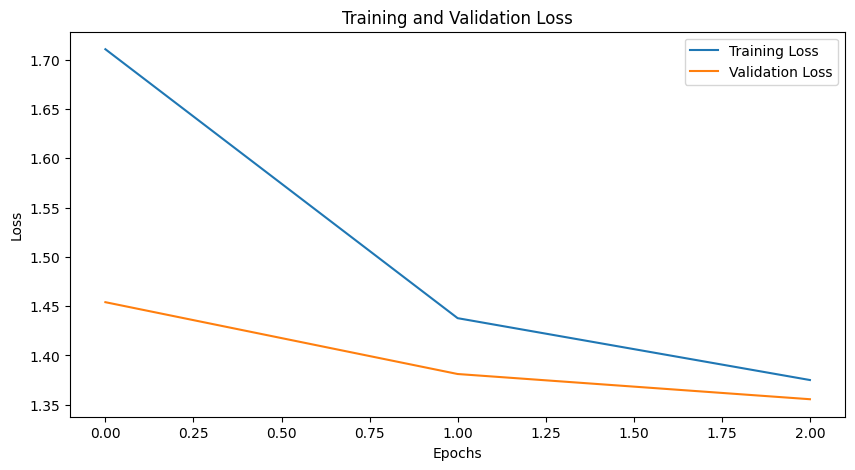

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


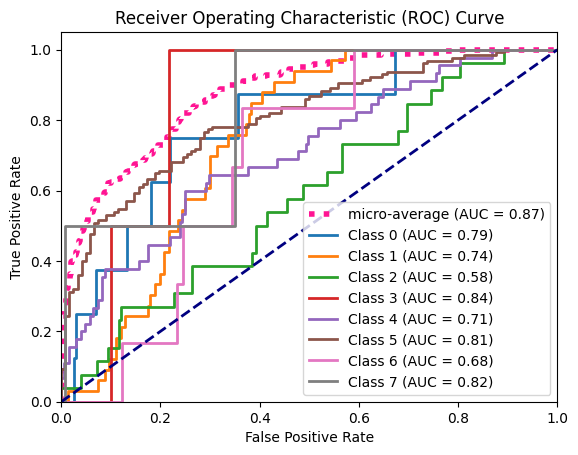

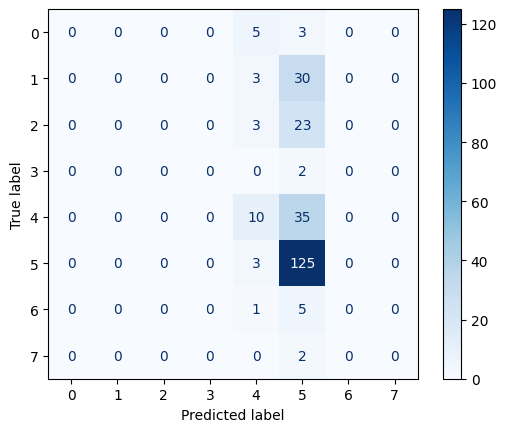

Accuracy: 0.5400000214576721
Precision: 0.35644444444444445
Recall: 0.54
F1 Score: 0.41403480372318896


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: GaussianBlur
Epoch 1/3
----------
train loss: 1.6577, acc: 0.4796
val loss: 1.4664, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4037, acc: 0.5102
val loss: 1.4025, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3393, acc: 0.5147
val loss: 1.3729, acc: 0.5242


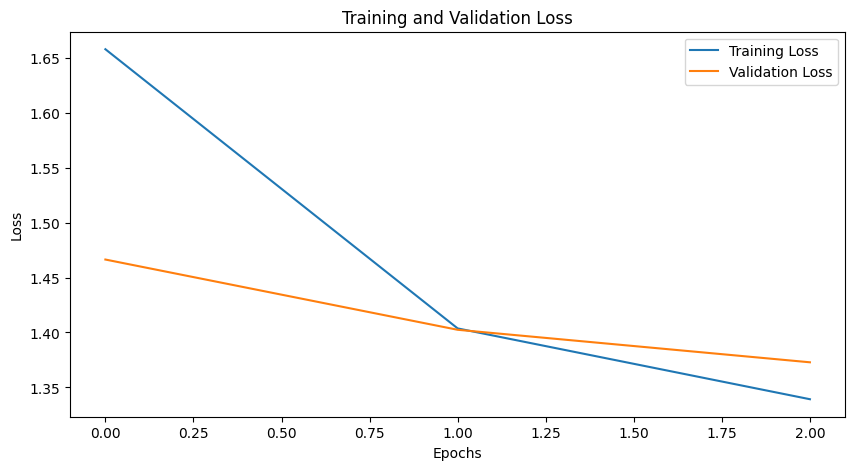

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


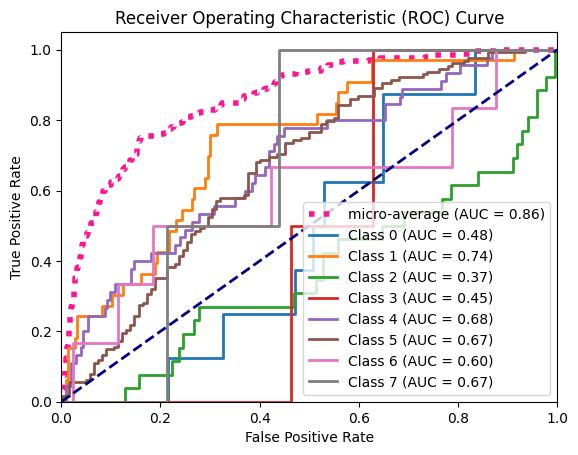

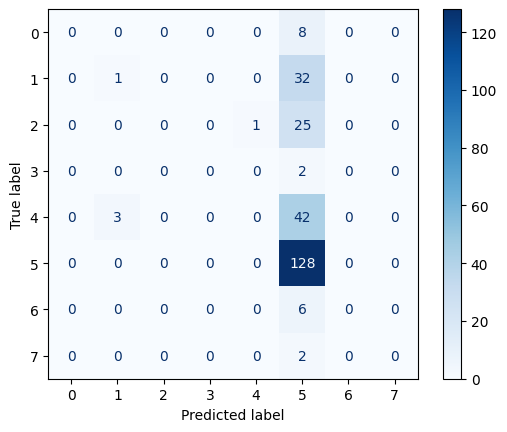

Accuracy: 0.515999972820282
Precision: 0.3004938775510204
Recall: 0.516
F1 Score: 0.35853459894210565


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomPerspective
Epoch 1/3
----------
train loss: 1.6571, acc: 0.4671
val loss: 1.4945, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4317, acc: 0.5102
val loss: 1.4307, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3955, acc: 0.5113
val loss: 1.4029, acc: 0.5161


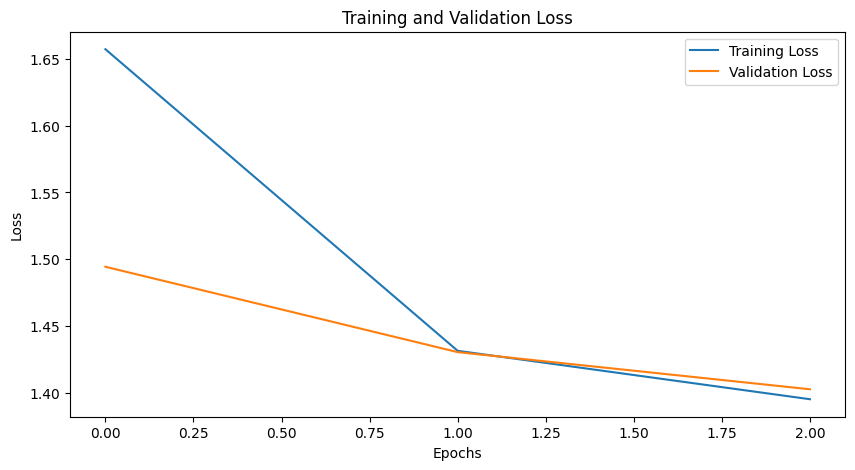

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


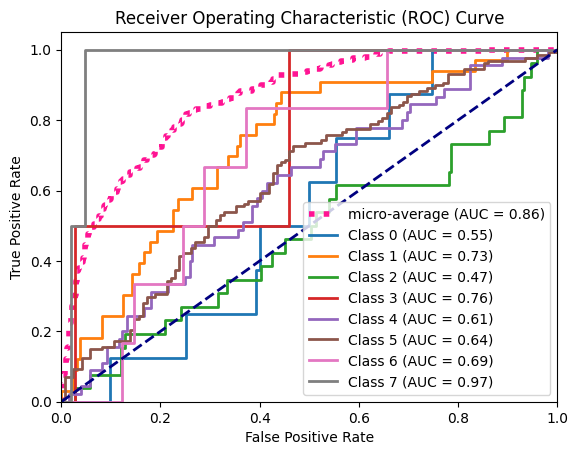

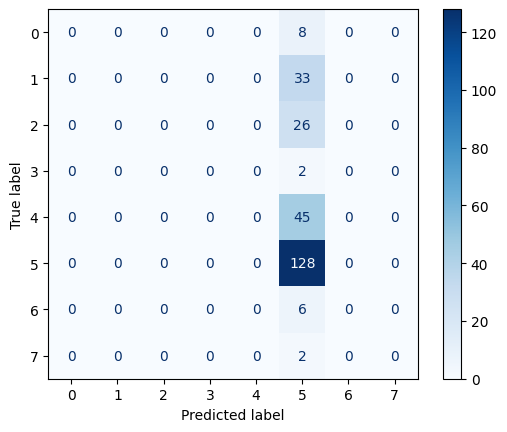

Accuracy: 0.5120000243186951
Precision: 0.262144
Recall: 0.512
F1 Score: 0.34675132275132275


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: Scaling
Epoch 1/3
----------
train loss: 1.6882, acc: 0.4399
val loss: 1.4470, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4137, acc: 0.5102
val loss: 1.3794, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3550, acc: 0.5147
val loss: 1.3253, acc: 0.5242


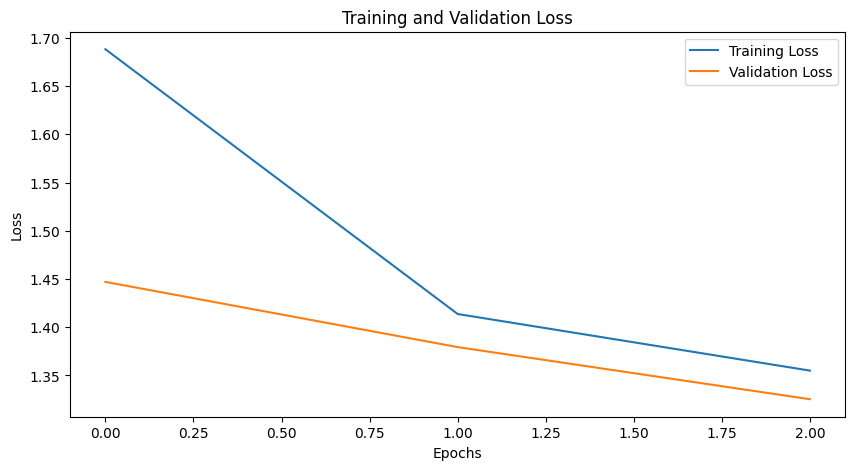

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


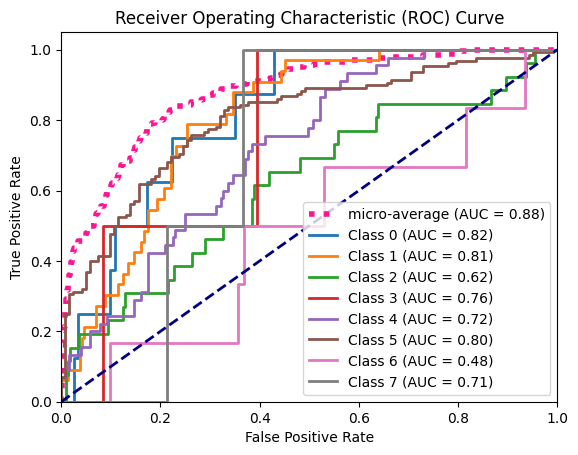

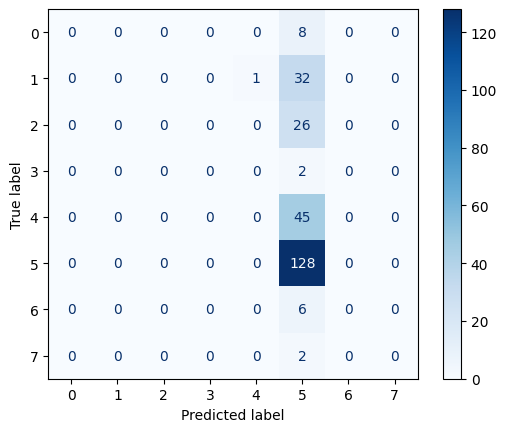

Accuracy: 0.5120000243186951
Precision: 0.26319678714859435
Recall: 0.512
F1 Score: 0.34767108753315645


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: Lambda
Epoch 1/3
----------
train loss: 1.7213, acc: 0.4342
val loss: 9.5842, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4536, acc: 0.5102
val loss: 11.0791, acc: 0.5161
Epoch 3/3
----------
train loss: 1.4349, acc: 0.5102
val loss: 12.4847, acc: 0.5161


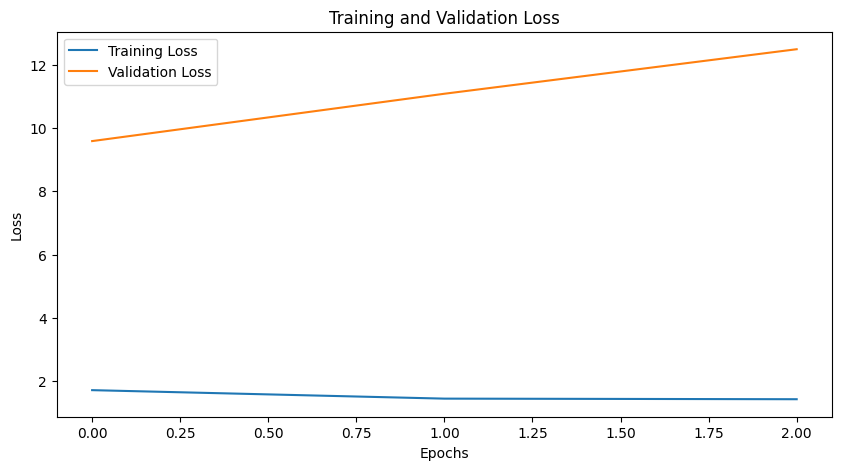

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


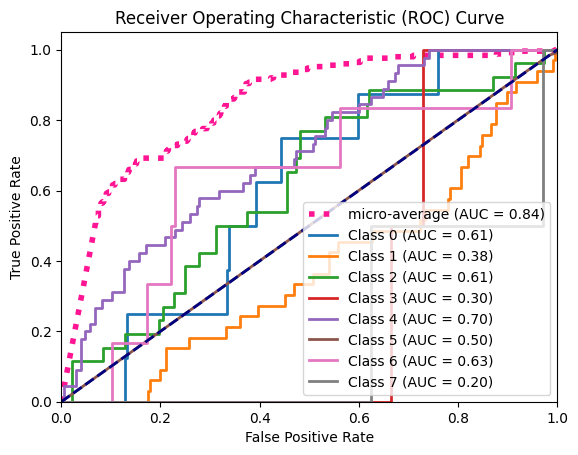

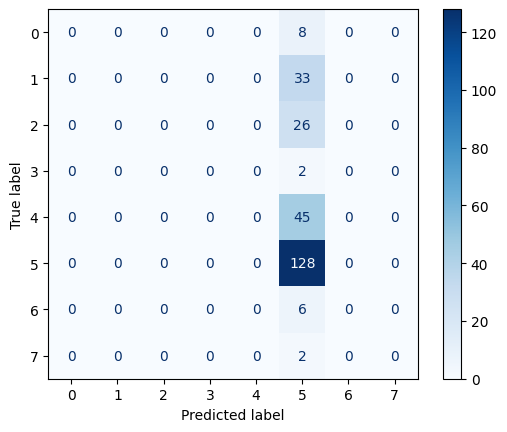

Accuracy: 0.5120000243186951
Precision: 0.262144
Recall: 0.512
F1 Score: 0.34675132275132275


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet reset
Training  ResNet50  with transformation: RandomErasing
Epoch 1/3
----------
train loss: 1.7559, acc: 0.4138
val loss: 1.4432, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4305, acc: 0.5102
val loss: 1.3892, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3964, acc: 0.5113
val loss: 1.3833, acc: 0.5403


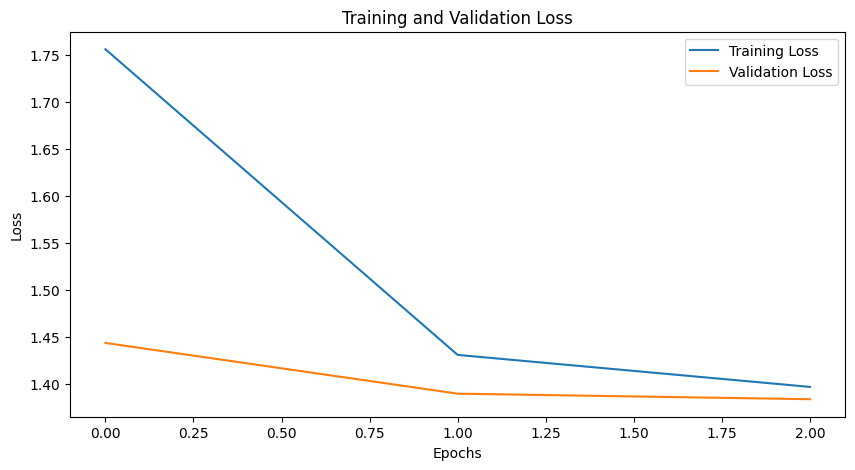

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


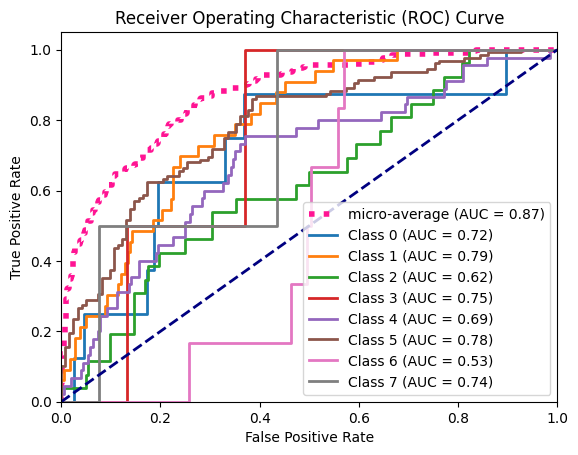

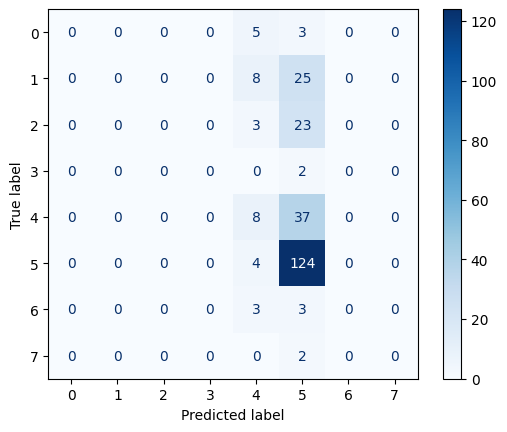

Accuracy: 0.527999997138977
Precision: 0.33635115628222123
Recall: 0.528
F1 Score: 0.4038198088882148


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 133MB/s]


DenseNet reset
Training  DenseNet121  with transformation: No_augmentation
Epoch 1/3
----------
train loss: 1.6757, acc: 0.4626
val loss: 1.4157, acc: 0.5161
Epoch 2/3
----------
train loss: 1.3906, acc: 0.5181
val loss: 1.3253, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3143, acc: 0.5261
val loss: 1.2798, acc: 0.5565


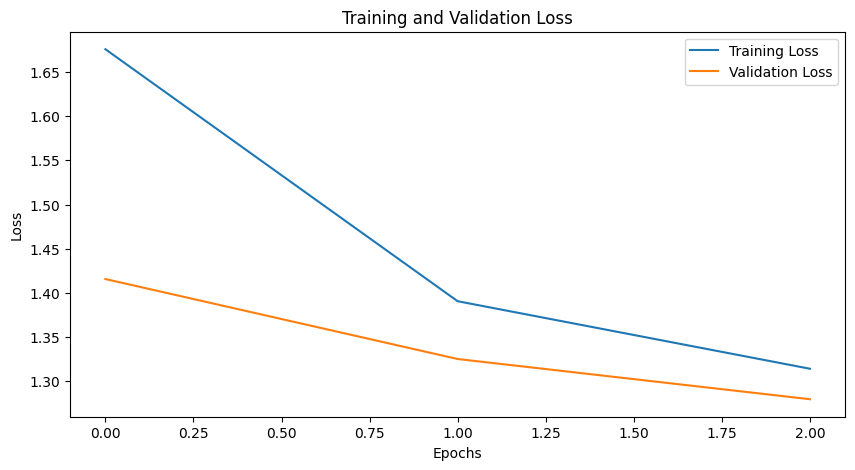

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


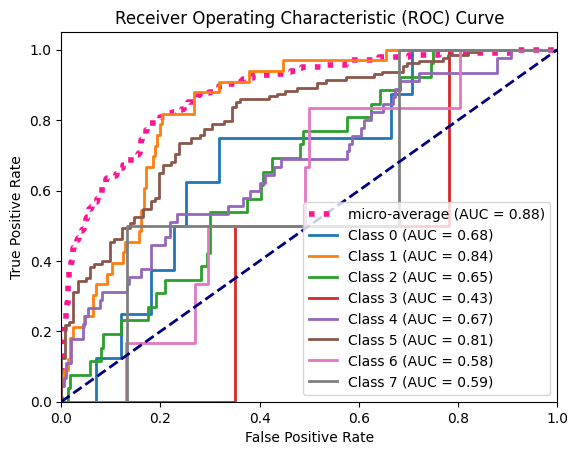

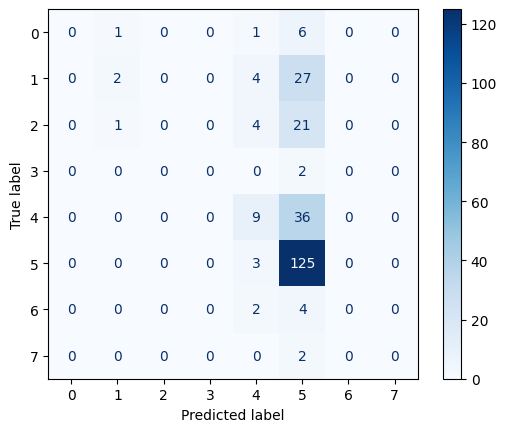

Accuracy: 0.5440000295639038
Precision: 0.42343029830376294
Recall: 0.544
F1 Score: 0.42658969376616424


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: GANs
Epoch 1/3
----------
train loss: 1.5271, acc: 0.4887
val loss: 1.3327, acc: 0.5161
Epoch 2/3
----------
train loss: 1.3858, acc: 0.5125
val loss: 1.2732, acc: 0.5806
Epoch 3/3
----------
train loss: 1.3339, acc: 0.5289
val loss: 1.2384, acc: 0.5887


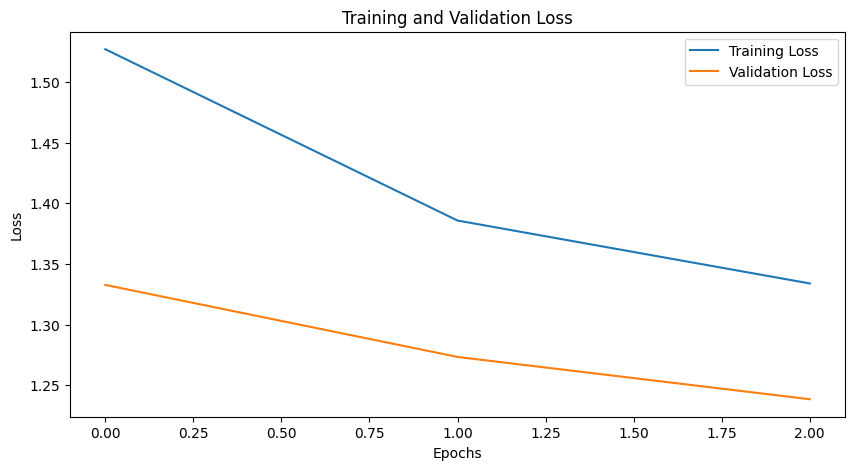

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


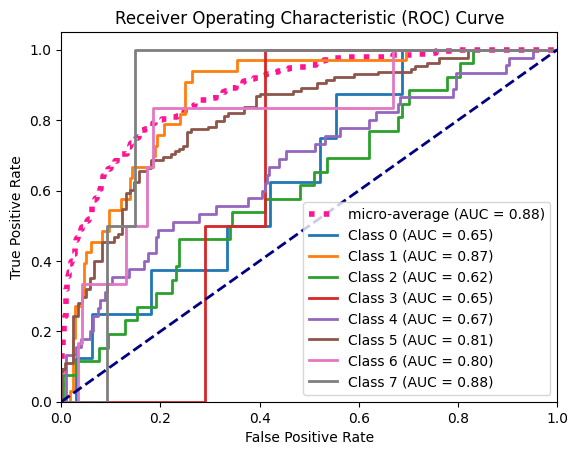

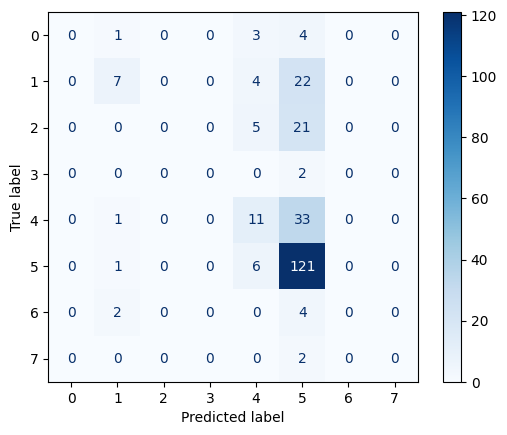

Accuracy: 0.5559999942779541
Precision: 0.4416969147005445
Recall: 0.556
F1 Score: 0.4622478359665303


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomHorizontalFlip
Epoch 1/3
----------
train loss: 1.6678, acc: 0.4512
val loss: 1.4256, acc: 0.5161
Epoch 2/3
----------
train loss: 1.3859, acc: 0.5159
val loss: 1.3453, acc: 0.5323
Epoch 3/3
----------
train loss: 1.3357, acc: 0.5227
val loss: 1.2894, acc: 0.5645


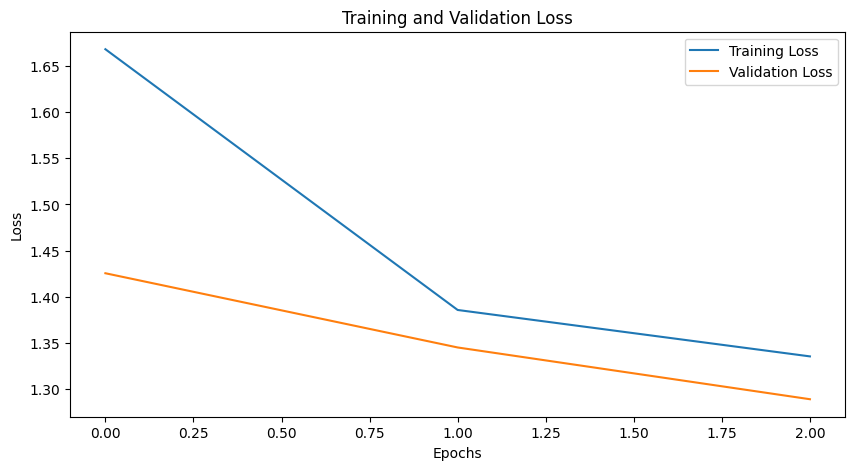

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


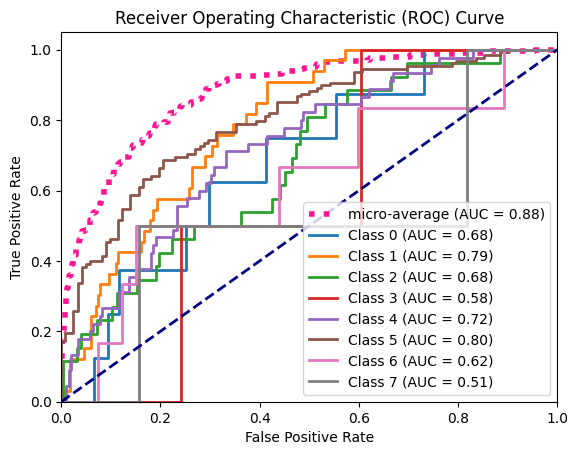

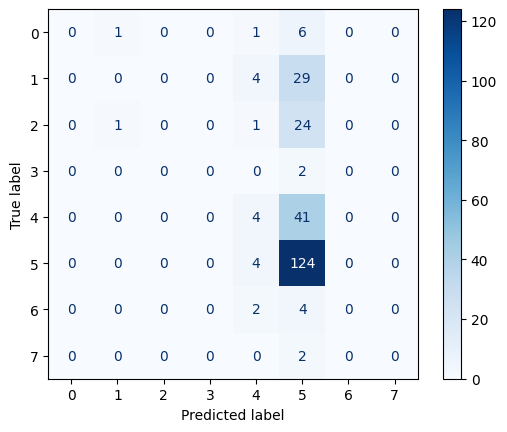

Accuracy: 0.5120000243186951
Precision: 0.3186551724137931
Recall: 0.512
F1 Score: 0.3763176684881603


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomRotation
Epoch 1/3
----------
train loss: 1.6928, acc: 0.4467
val loss: 1.4145, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4061, acc: 0.5136
val loss: 1.3487, acc: 0.5242
Epoch 3/3
----------
train loss: 1.3451, acc: 0.5159
val loss: 1.3228, acc: 0.5726


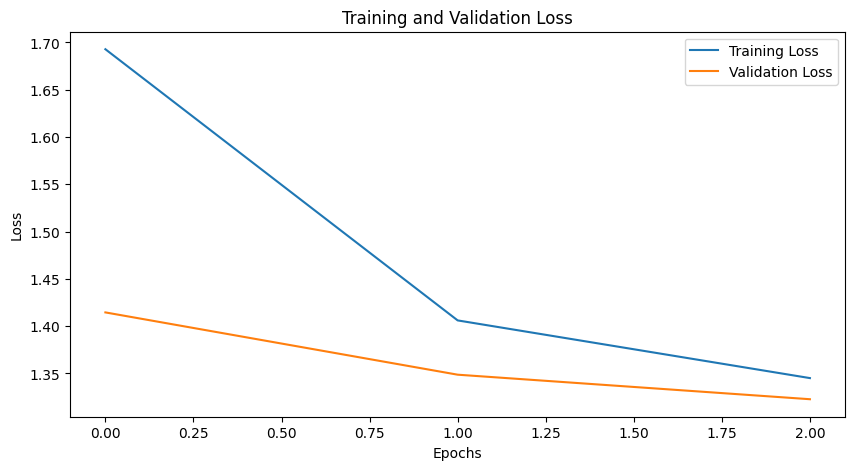

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


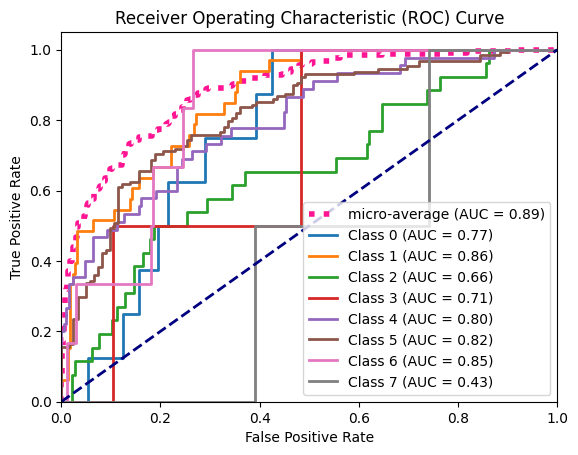

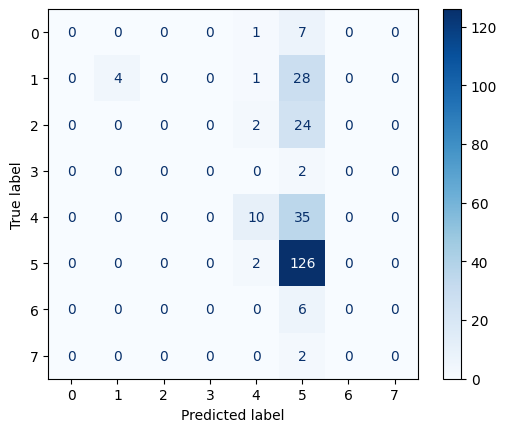

Accuracy: 0.5600000023841858
Precision: 0.5249869565217391
Recall: 0.56
F1 Score: 0.44795916862003504


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomResizedCrop
Epoch 1/3
----------
train loss: 1.6746, acc: 0.4592
val loss: 1.3971, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4234, acc: 0.5125
val loss: 1.3230, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3643, acc: 0.5113
val loss: 1.2726, acc: 0.5484


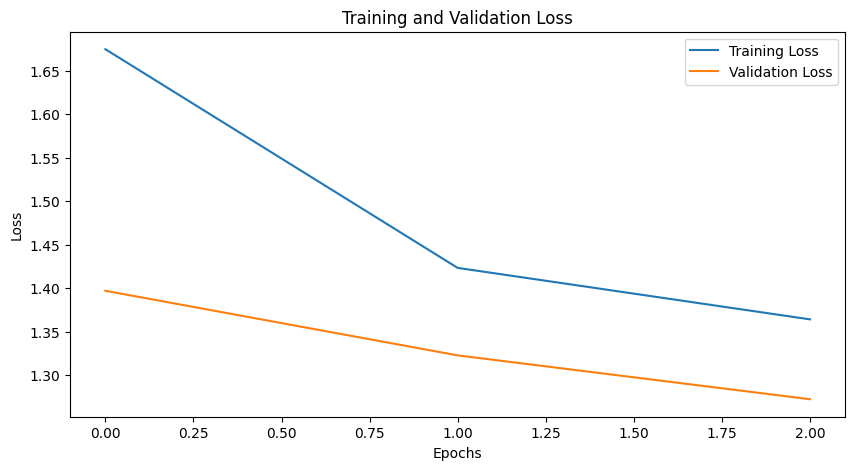

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


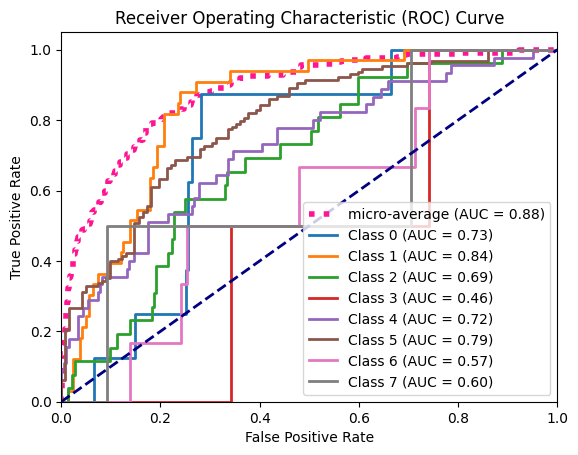

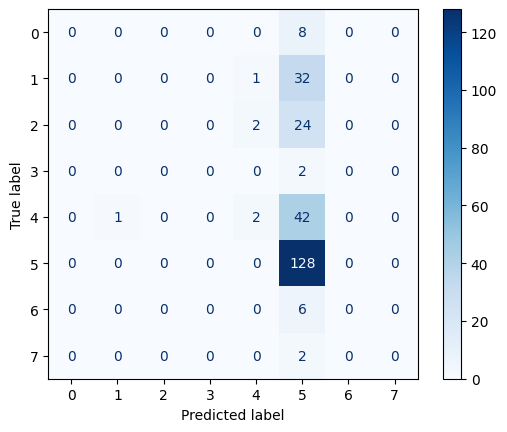

Accuracy: 0.5199999809265137
Precision: 0.34059016393442626
Recall: 0.52
F1 Score: 0.3667440860215053


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomAffine
Epoch 1/3
----------
train loss: 1.6938, acc: 0.4240
val loss: 1.4392, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4042, acc: 0.5181
val loss: 1.3648, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3402, acc: 0.5159
val loss: 1.3217, acc: 0.5242


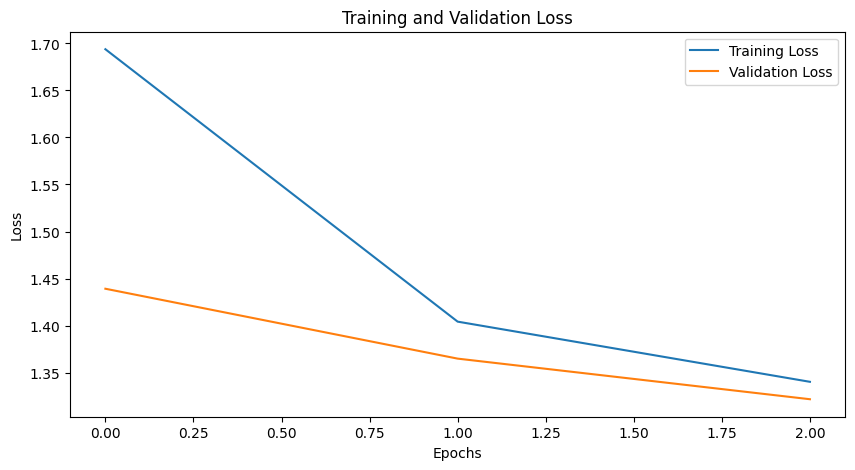

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


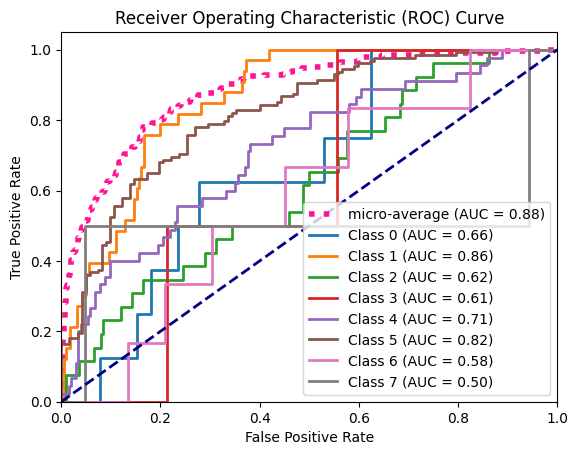

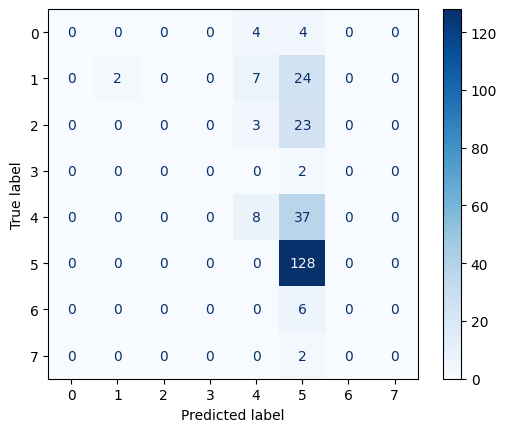

Accuracy: 0.5519999861717224
Precision: 0.4874368463395012
Recall: 0.552
F1 Score: 0.42833067591822965


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: ColorJitter
Epoch 1/3
----------
train loss: 1.6565, acc: 0.4626
val loss: 1.4215, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4152, acc: 0.5159
val loss: 1.3489, acc: 0.5242
Epoch 3/3
----------
train loss: 1.3787, acc: 0.5215
val loss: 1.3406, acc: 0.5242


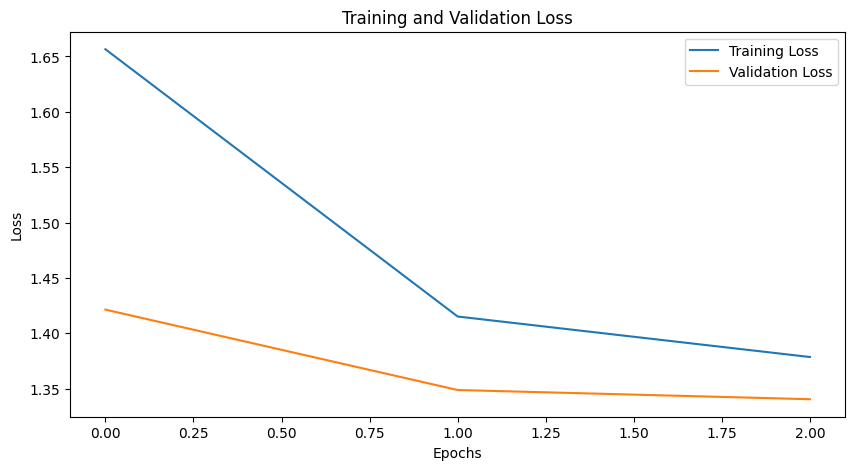

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


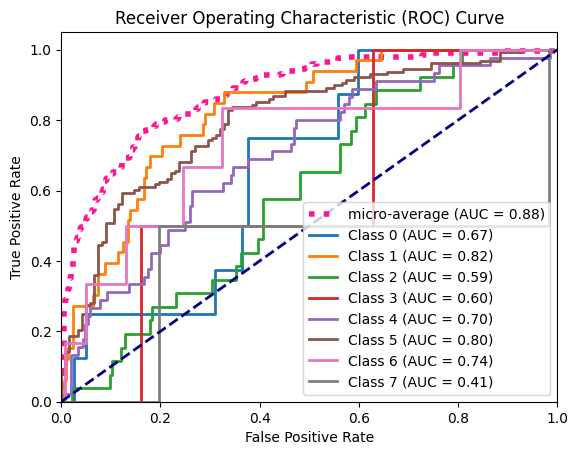

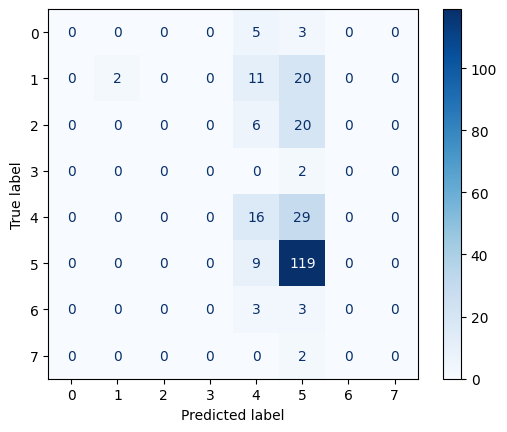

Accuracy: 0.5479999780654907
Precision: 0.4973171717171717
Recall: 0.548
F1 Score: 0.4495087042760275


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: GaussianBlur
Epoch 1/3
----------
train loss: 1.7844, acc: 0.3991
val loss: 1.4062, acc: 0.5161
Epoch 2/3
----------
train loss: 1.3922, acc: 0.5136
val loss: 1.3597, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3307, acc: 0.5181
val loss: 1.3417, acc: 0.5323


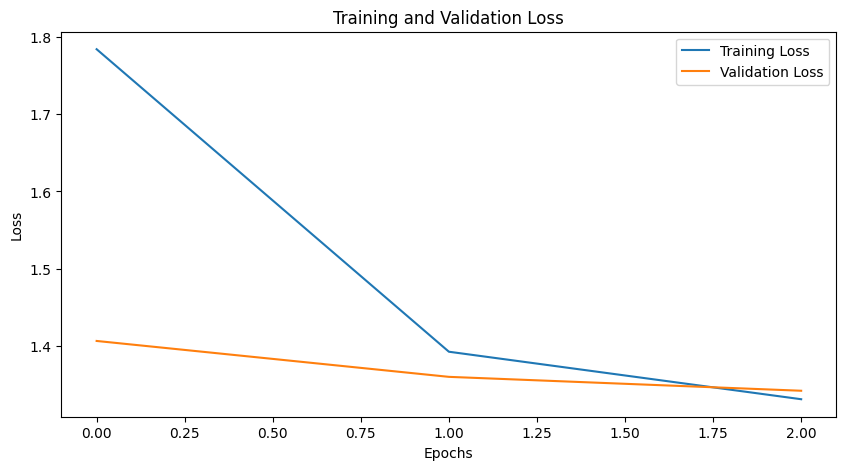

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


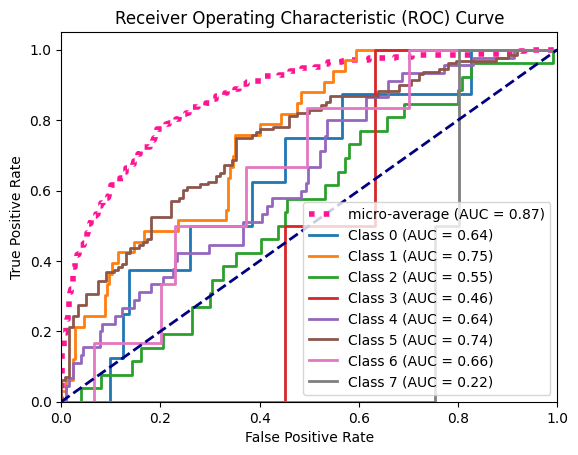

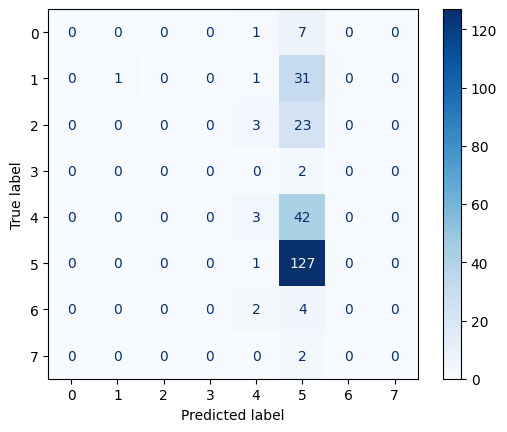

Accuracy: 0.5239999890327454
Precision: 0.4543009931245225
Recall: 0.524
F1 Score: 0.3823728245396519


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomPerspective
Epoch 1/3
----------
train loss: 1.7158, acc: 0.4229
val loss: 1.4744, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4107, acc: 0.5125
val loss: 1.4061, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3645, acc: 0.5181
val loss: 1.4039, acc: 0.5000


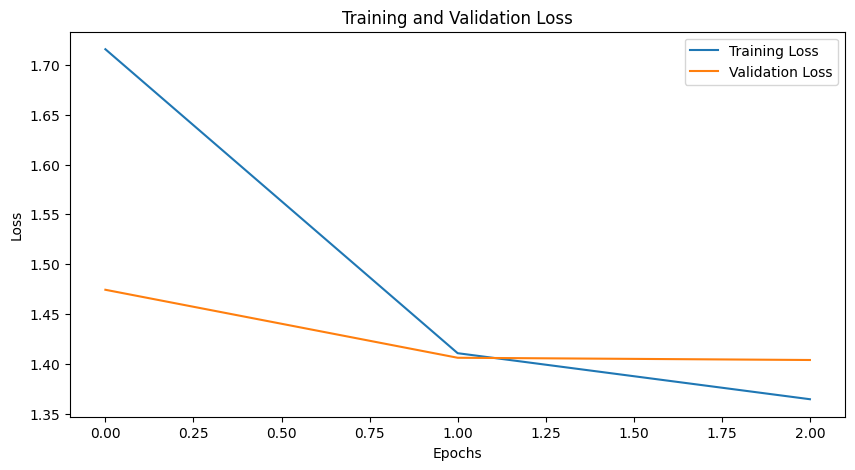

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


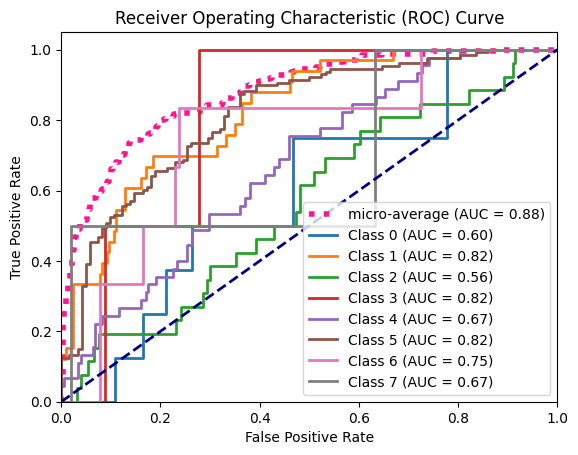

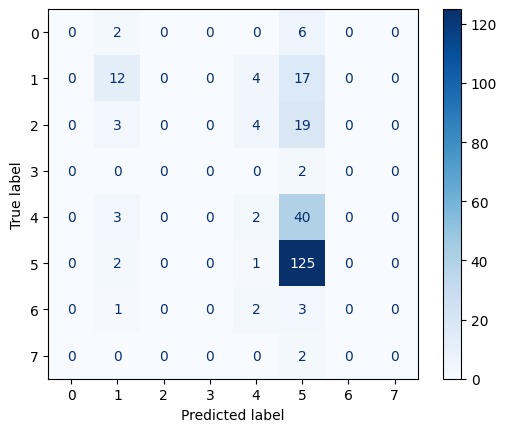

Accuracy: 0.5559999942779541
Precision: 0.3956272934704467
Recall: 0.556
F1 Score: 0.44325422752283006


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: Scaling
Epoch 1/3
----------
train loss: 1.6736, acc: 0.4546
val loss: 1.4083, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4259, acc: 0.5091
val loss: 1.3235, acc: 0.5242
Epoch 3/3
----------
train loss: 1.3475, acc: 0.5215
val loss: 1.2639, acc: 0.5484


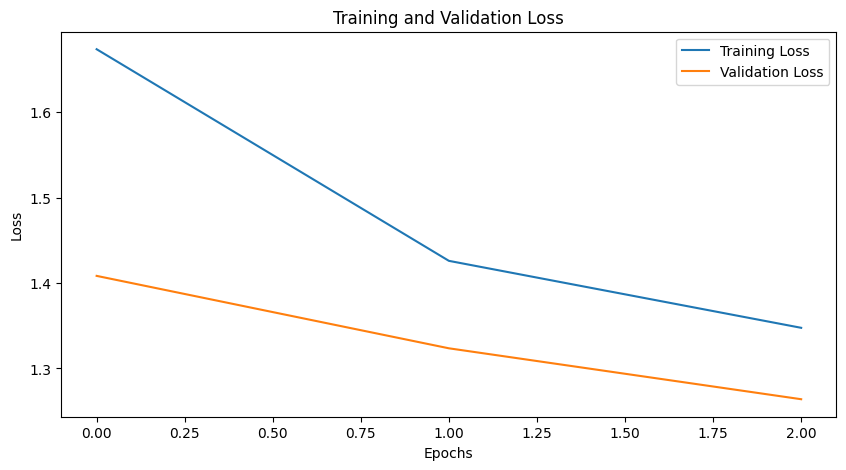

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


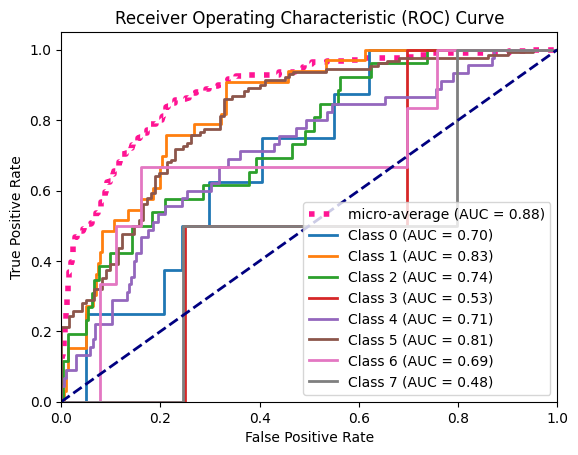

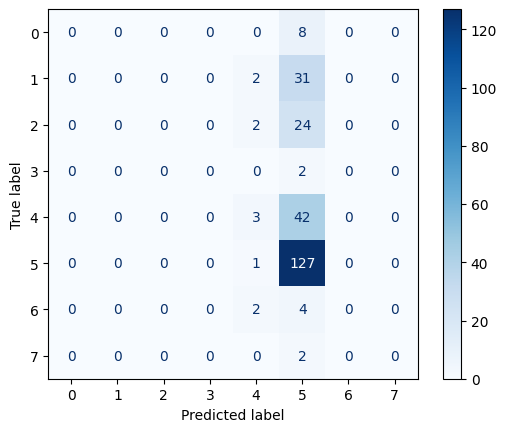

Accuracy: 0.5199999809265137
Precision: 0.32493333333333335
Recall: 0.52
F1 Score: 0.3730276679841897


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: Lambda
Epoch 1/3
----------
train loss: 1.6665, acc: 0.4546
val loss: 2.5409, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4502, acc: 0.5091
val loss: 3.4122, acc: 0.5161
Epoch 3/3
----------
train loss: 1.4207, acc: 0.5102
val loss: 2.7082, acc: 0.5161


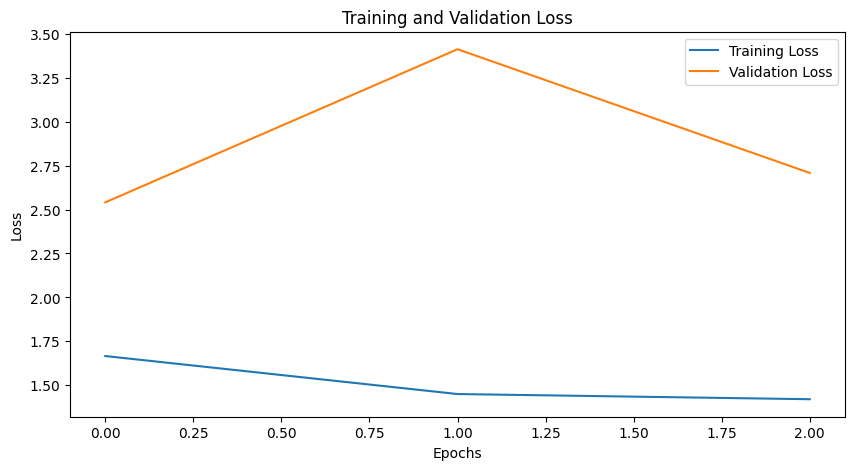

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


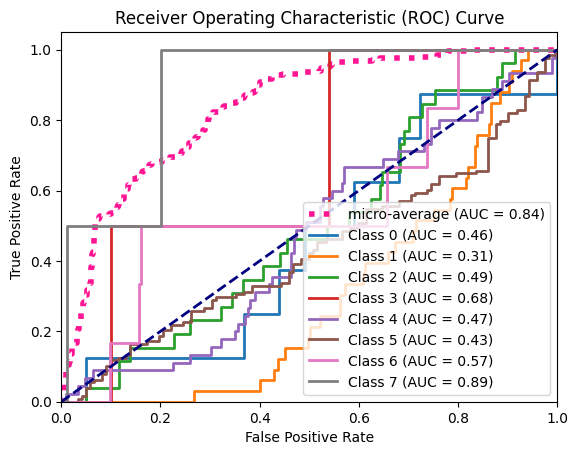

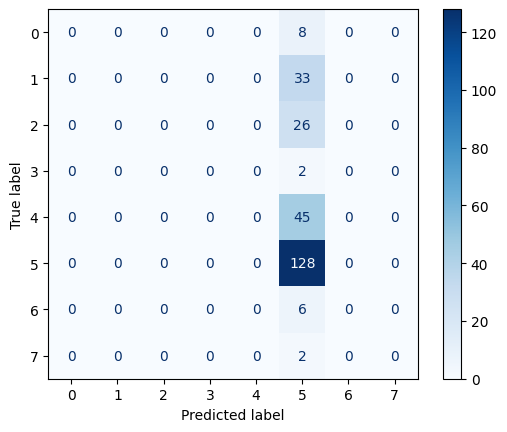

Accuracy: 0.5120000243186951
Precision: 0.262144
Recall: 0.512
F1 Score: 0.34675132275132275


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DenseNet reset
Training  DenseNet121  with transformation: RandomErasing
Epoch 1/3
----------
train loss: 1.7278, acc: 0.4172
val loss: 1.4607, acc: 0.5161
Epoch 2/3
----------
train loss: 1.4370, acc: 0.5091
val loss: 1.3798, acc: 0.5161
Epoch 3/3
----------
train loss: 1.3832, acc: 0.5159
val loss: 1.3636, acc: 0.5565


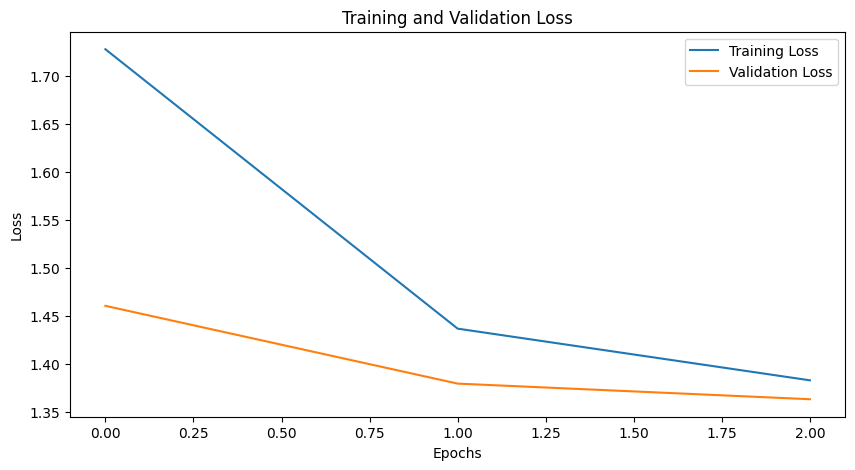

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


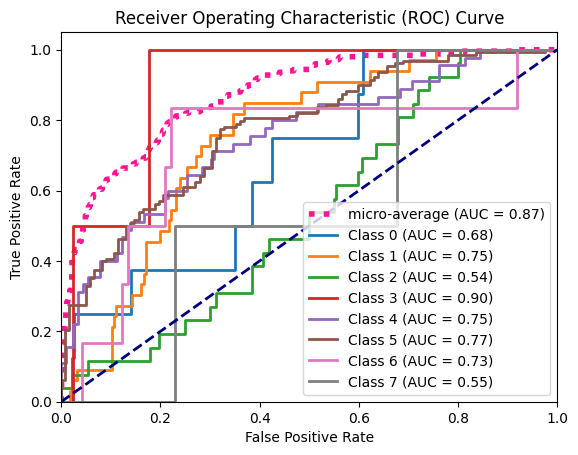

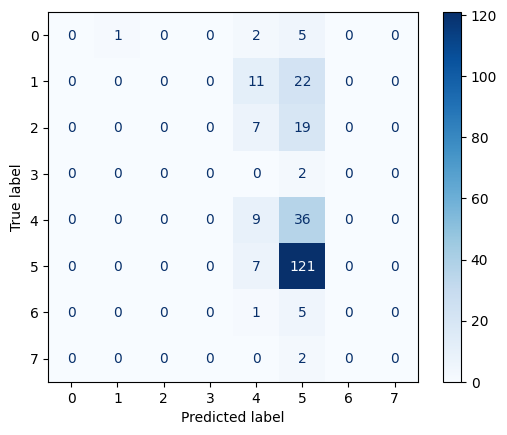

Accuracy: 0.5199999809265137
Precision: 0.33601019887812344
Recall: 0.52
F1 Score: 0.4039357245337159


In [ ]:
content_directory = os.path.join(data_and_graphs_path, 'Results')
os.makedirs(content_directory, exist_ok=True) ###setting up results folder

#names of models I'm using
modelNames = ['ResNet50', 'DenseNet121']

#different folders of transformation
transformationFolders = {
    'No_augmentation': [None],  #use None to represent no augmentation
    'GANs_augmentation': [None], #also none, because the generated data is 'manually' added to the dataset, not using a library function
    'Basic_augmentation_set_1': transformationsBeforeTensor, #transformations that need to be done before image is turned to tensor
    'Scaling_augmentation': transformationScaling, #also neeeds to be done before turned to tensor but needs to be in seperate folder (explained above)
    'Basic_augmentation_set_2': transformationsAfterTensor, #transformations that need to be done after the image is turned into a tensor

}

for modelName in modelNames: #for each model
  for transformationFolder, transformations in transformationFolders.items(): #for each folder of transformations
    for transformation in transformations: #for each transformation in that folder

      ##initialising model
      if modelName == 'ResNet50':
        model, device, model.fc, criterion, optimizer, scheduler, model_name = initialize_model_ResNet()
        print("ResNet reset")
      else:
        model, device, model.fc, criterion, optimizer, scheduler, model_name = initialize_model_DenseNet()
        print("DenseNet reset")

      ##creating directory to store results for specific model
      base_directory = os.path.join(content_directory, model_name)
      os.makedirs(base_directory, exist_ok=True)


      ##outlining the name of the transformations
      if transformationFolder == 'No_augmentation':
        transformation_name = 'No_augmentation'
      elif transformationFolder == 'GANs_augmentation':
        transformation_name = 'GANs'
      elif transformationFolder == 'Scaling_augmentation':
        transformation_name = 'Scaling'
      else:
        transformation_name = transformation.__class__.__name__

      ##tells you whats happening
      print("Training ", modelName, " with transformation:", transformation_name)

      ##reset the data to prevent data leakage
      image_datasets['train'], dataloaders['train'] = resetData()

      ##only use this function to visualise the data augmented with basic techniques
      if transformationFolder != 'No_augmentation' and transformationFolder != 'GANs_augmentation':
        visualize_augmented_data(image_datasets['train'], transformation, base_directory, transformation_name, means_content, stds_content)

      #selecting which data load method to use, no_augmentation doesnt satisfy any of these so just uses the initial data from resetData()
      if transformationFolder == 'GANs_augmentation':
        image_datasets['train'], dataloaders['train'] = GANsDataLoad()
      elif transformationFolder == 'Basic_augmentation_set_1' or transformationFolder == 'Scaling_augmentation':
        image_datasets['train'], dataloaders['train'] = augmentDataBeforeTensor(transformation)
      elif transformationFolder == 'Basic_augmentation_set_2':
        image_datasets['train'], dataloaders['train'] = augmentDataAfterTensor(transformation)



      ##training
      model_trained, train_losses, train_accs, val_losses, val_accs = train_model(model, criterion, optimizer, num_epochs=CNN_Epochs)

      ##loss plot
      plot_and_save_losses(train_losses, val_losses, base_directory, transformation_name, 'loss.png') #create loss plot for train val loss

      ##model evaluation
      model_trained.eval() #switch to model testing

      #calculates metrics and saves graphs
      evaluate_model_and_save_results(model_trained, dataloaders, device, base_directory, transformation_name)


#**Visualisation of Results**..

##setup for visualisation

###More readable transformation names

In [ ]:
plot_names = {}
plot_names["RandomHorizontalFlip"] = "Horizontal Flip"
plot_names["RandomRotation"] = "Rotation"
plot_names["RandomResizedCrop"] = "Cropping"
plot_names["RandomAffine"] = "Translation"
plot_names["ColorJitter"] = "Colour Change"
plot_names["GaussianBlur"] = "Gaussian Blurring"
plot_names["RandomPerspective"] = "Perspective Change"
plot_names["Scaling"] = "Scaling"
plot_names["Lambda"] = "Noise Injection"
plot_names["RandomErasing"] = "Random Erasing"
plot_names["No_augmentation"] = "No Augmentation"
plot_names["GANs"] = "GANs"
#the transformation names are too 'computery' and sometimes confusing. Like lambda is noise injection. Just makes it more readable

###Combining CSV files for each model - dont need to run again

In [ ]:
"""The CSV files would have been already be in one CSV for each model if the code ran correctly first try, but in practice the code for cGAN used too much RAM.
So, while I ammended the code for the cGAN to use a batch size to handle RAM, I just ran the basic augmentations. This resulted in 2 runs, so 2 CSV files  for each model"""

#ResNet
ResNetCSV1 = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/AdrianResults/myResults/Results/ResNet50/ResNet50_Results.CSV')#CSV for basic augs / no aug
ResNetCSV2 = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/AdrianResults/myResults/GANs/Results/ResNet50/GANs/results.csv') #CSV with GANs

combined_ResNet = pd.concat([ResNetCSV1, ResNetCSV2], ignore_index=True) #combine them

combined_ResNet.to_csv('/content/drive/MyDrive/Synoptic_Final/ResNet50_results.csv', index=False) #save it

#Same again for DenseNet
DenseNetCSV1 = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/AdrianResults/myResults/Results/DenseNet121/DenseNet121_Results.CSV')
DenseNetCSV2 = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/AdrianResults/myResults/GANs/Results/DenseNet121/GANs/results.csv')

combined_DenseNet = pd.concat([DenseNetCSV1, DenseNetCSV2], ignore_index=True)

combined_DenseNet.to_csv('/content/drive/MyDrive/Synoptic_Final/DenseNet121_results.csv', index=False)

In [ ]:
ResNetResultsDF = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/ResNet50_results.csv')
print(ResNetResultsDF)

          transformation  accuracy  precision    recall  f1_score
0   RandomHorizontalFlip  0.682285   0.659232  0.682285  0.655389
1          RandomErasing  0.633650   0.598565  0.633650  0.602834
2           RandomAffine  0.681890   0.661764  0.681890  0.655974
3                 Lambda  0.508699   0.258775  0.508699  0.343044
4      RandomPerspective  0.577699   0.606989  0.577699  0.573988
5         RandomRotation  0.670621   0.638109  0.670621  0.641133
6                Scaling  0.669632   0.636861  0.669632  0.637999
7            ColorJitter  0.650059   0.625026  0.650059  0.603436
8      RandomResizedCrop  0.651839   0.623750  0.651839  0.616027
9        No_augmentation  0.694741   0.668127  0.694741  0.667948
10          GaussianBlur  0.563662   0.508988  0.563662  0.486805
11                  GANs  0.675563   0.644178  0.675563  0.643874


In [ ]:
DenseNetResultsDF = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/DenseNet121_results.csv')
print(DenseNetResultsDF)

          transformation  accuracy  precision    recall  f1_score
0   RandomHorizontalFlip  0.694148   0.686136  0.694148  0.679864
1          RandomErasing  0.623171   0.587264  0.623171  0.579663
2           RandomAffine  0.661329   0.648859  0.661329  0.643055
3                 Lambda  0.508699   0.258775  0.508699  0.343044
4      RandomPerspective  0.610320   0.613806  0.610320  0.581306
5         RandomRotation  0.659747   0.644523  0.659747  0.632994
6                Scaling  0.676750   0.664500  0.676750  0.648431
7            ColorJitter  0.653223   0.598284  0.653223  0.603405
8      RandomResizedCrop  0.668446   0.632665  0.668446  0.636616
9        No_augmentation  0.689403   0.665456  0.689403  0.658705
10          GaussianBlur  0.593318   0.558126  0.593318  0.526383
11                  GANs  0.675168   0.639664  0.675168  0.640591


###Function to display graphs to show each augmentation's metrics relative to the metrics of no augmentation

In [ ]:
def plot_relative_performance(csv_path, model_name):

    df = pd.read_csv(csv_path) #load CSV


    df['readable_transformation'] = df['transformation'].map(plot_names)  #get the more readable names

    baseline = df[df['transformation'] == 'No_augmentation'] #find no augmentation row

    metrics = ['accuracy', 'precision', 'recall', 'f1_score'] #metrics to plot

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 15)) #set up plotting environemnt
    axes = axes.flatten()  #flattened array makes iterating easier

    for i, metric in enumerate(metrics): #plotting each metric
        baseline_metric = baseline[metric].values[0] #get baseline from no augmentation

        df[f'diff_{metric}'] = df[metric] - baseline_metric #calc difference from no augmentation

        filtered_df = df[df['transformation'] != 'No_augmentation'] #filter out no augmentation so that it doesnt get plotted

        axes[i].bar(filtered_df['readable_transformation'], filtered_df[f'diff_{metric}'], color='lightblue', label='Relative Performance') #plot bar for each augmentation
        axes[i].axhline(0, color='red', linewidth=2, label='No Augmentation Baseline') #plot the no augmentation baseline

        axes[i].grid(True, which='both', linestyle='--', linewidth=0.5) #get a grid

        axes[i].set_title(f'Relative {metric.capitalize()} on {model_name}', fontsize=20)
        axes[i].set_ylabel(f'Difference in {metric.capitalize()}', fontsize=16)
        axes[i].set_xlabel('Augmentation Type', fontsize=18)
        axes[i].tick_params(axis='x', rotation=90, labelsize=16)
        axes[i].tick_params(axis='y', labelsize=12)
        axes[i].legend()  #aesthetics

    plt.tight_layout() #stops each plot overlapping
    #this_fig_save_location = os.path.join(save_plots_for_presentation_location, model_name)
    #plt.savefig(this_fig_save_location)
    plt.show()


###Function to display 2 images side by side with titles - used to display loss plot and confusion matrix for a given augmentation

In [ ]:
def display_images_with_titles(image1_path, title1, image2_path, title2, save_name):

    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path) #load images from path

    fig, axes = plt.subplots(1, 2, figsize=(12, 6)) #show images

    axes[0].imshow(img1)
    axes[0].set_title(title1)
    axes[0].axis('off') #put first one on the left

    axes[1].imshow(img2)
    axes[1].set_title(title2)
    axes[1].axis('off') #second on the right

    plt.tight_layout()
    #this_fig_save_location = os.path.join(save_plots_for_presentation_location, save_name)
    #plt.savefig(this_fig_save_location)
    plt.show()


paths_to_noteable_imgs = '/content/drive/MyDrive/Synoptic_Final/NoteableGraphs'
ResNet_noteable_imgs = os.path.join(paths_to_noteable_imgs, 'ResNet')
DenseNet_noteable_imgs = os.path.join(paths_to_noteable_imgs, 'DenseNet') #path shortcuts to where particular graphs are saved

##Pure results

In [ ]:
ResNetResultsDF = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/ResNet50_results.csv')
print(ResNetResultsDF)

          transformation  accuracy  precision    recall  f1_score
0   RandomHorizontalFlip  0.682285   0.659232  0.682285  0.655389
1          RandomErasing  0.633650   0.598565  0.633650  0.602834
2           RandomAffine  0.681890   0.661764  0.681890  0.655974
3                 Lambda  0.508699   0.258775  0.508699  0.343044
4      RandomPerspective  0.577699   0.606989  0.577699  0.573988
5         RandomRotation  0.670621   0.638109  0.670621  0.641133
6                Scaling  0.669632   0.636861  0.669632  0.637999
7            ColorJitter  0.650059   0.625026  0.650059  0.603436
8      RandomResizedCrop  0.651839   0.623750  0.651839  0.616027
9        No_augmentation  0.694741   0.668127  0.694741  0.667948
10          GaussianBlur  0.563662   0.508988  0.563662  0.486805
11                  GANs  0.675563   0.644178  0.675563  0.643874


In [ ]:
DenseNetResultsDF = pd.read_csv('/content/drive/MyDrive/Synoptic_Final/DenseNet121_results.csv')
print(DenseNetResultsDF)

          transformation  accuracy  precision    recall  f1_score
0   RandomHorizontalFlip  0.694148   0.686136  0.694148  0.679864
1          RandomErasing  0.623171   0.587264  0.623171  0.579663
2           RandomAffine  0.661329   0.648859  0.661329  0.643055
3                 Lambda  0.508699   0.258775  0.508699  0.343044
4      RandomPerspective  0.610320   0.613806  0.610320  0.581306
5         RandomRotation  0.659747   0.644523  0.659747  0.632994
6                Scaling  0.676750   0.664500  0.676750  0.648431
7            ColorJitter  0.653223   0.598284  0.653223  0.603405
8      RandomResizedCrop  0.668446   0.632665  0.668446  0.636616
9        No_augmentation  0.689403   0.665456  0.689403  0.658705
10          GaussianBlur  0.593318   0.558126  0.593318  0.526383
11                  GANs  0.675168   0.639664  0.675168  0.640591


##Graphs to show differences in metrics

###ResNet Metrics Graphs

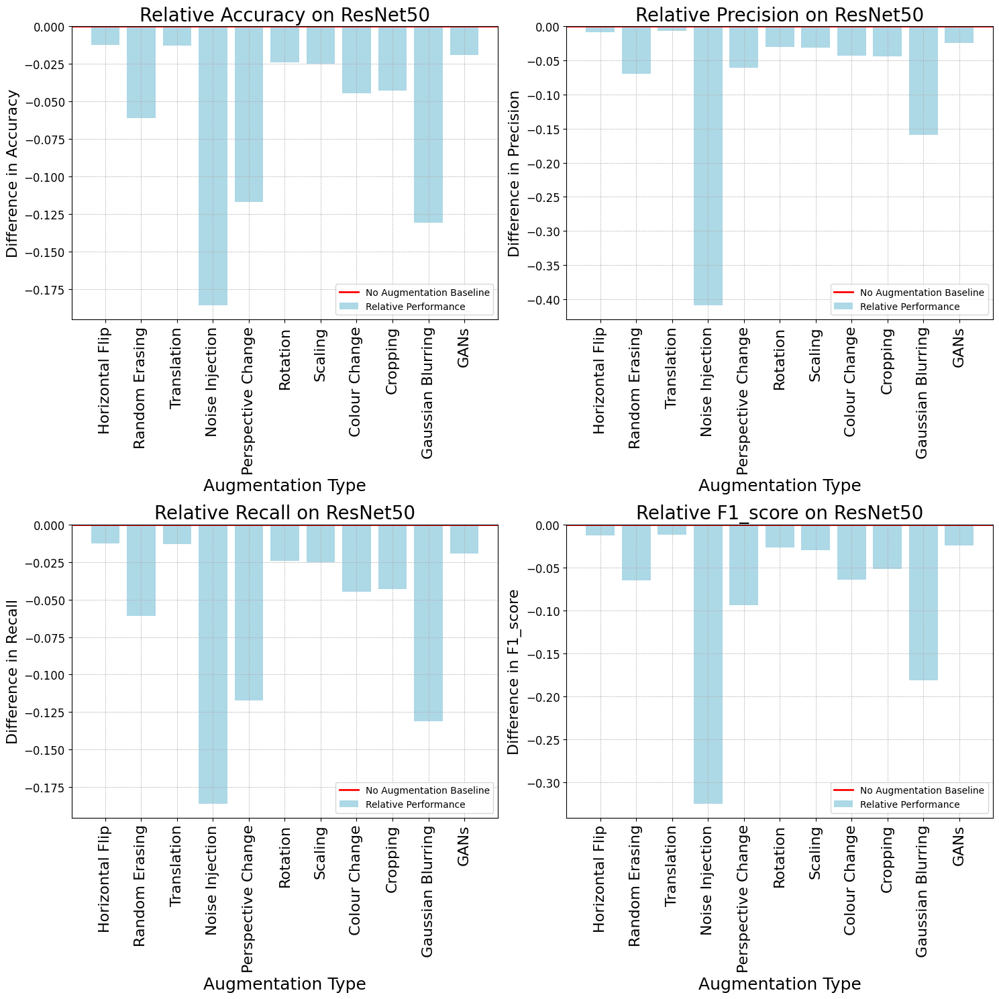

In [ ]:
plot_relative_performance('/content/drive/MyDrive/Synoptic_Final/ResNet50_results.csv', 'ResNet50')

###DenseNet121 results graph

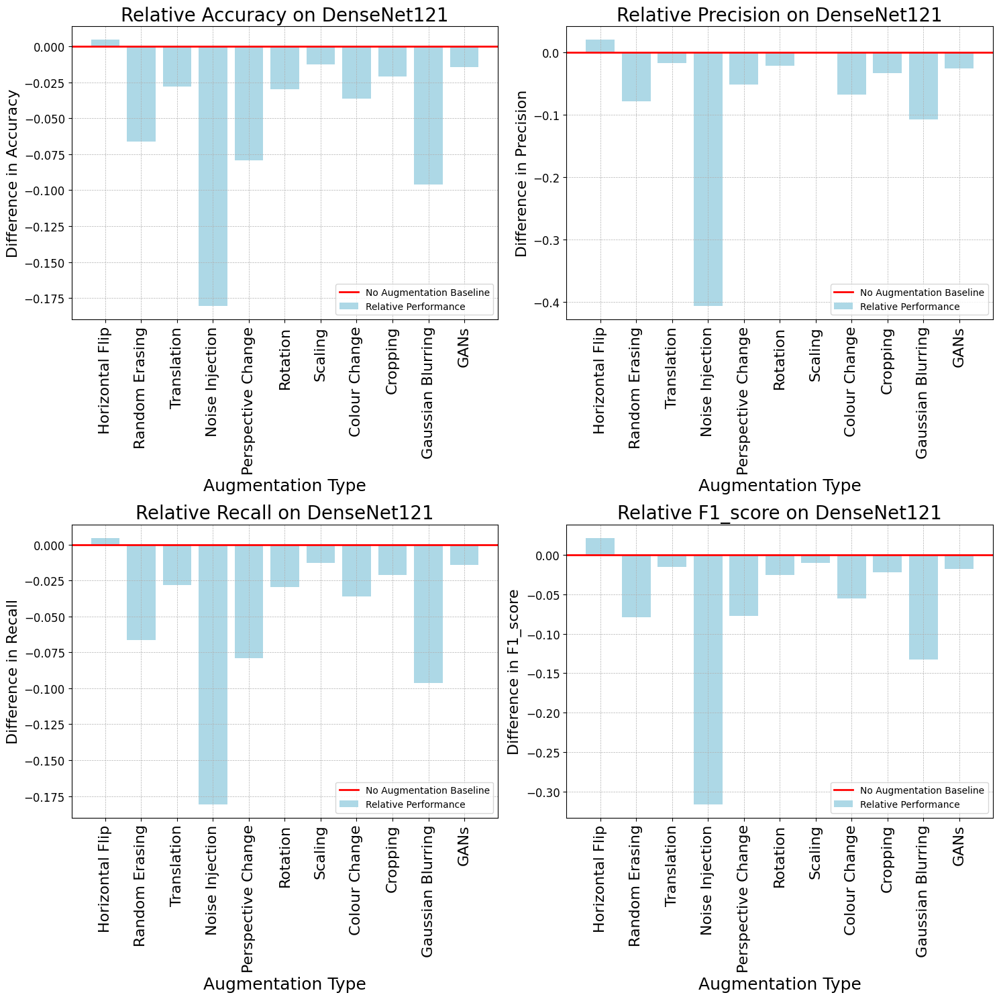

In [ ]:
plot_relative_performance('/content/drive/MyDrive/Synoptic_Final/DenseNet121_results.csv', 'DenseNet121')

##Training and Validation Loss Graphs/ Confusion Matrices

###ResNet50

####Best Performer - No augmentation

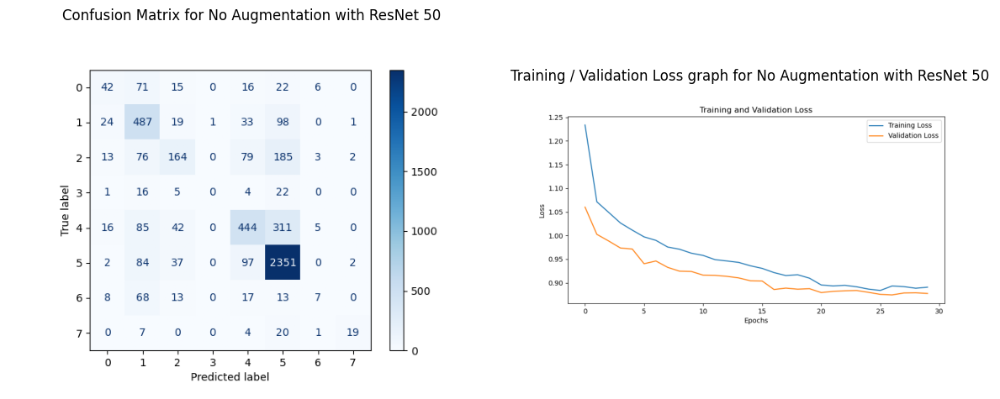

In [ ]:
ResNet_noaug_path = os.path.join(ResNet_noteable_imgs, 'No_aug')
conf_mat_path = os.path.join(ResNet_noaug_path, 'Copy of Conf_mat.png')
conf_mat_title = "Confusion Matrix for No Augmentation with ResNet 50"
loss_plot_path = os.path.join(ResNet_noaug_path, 'Copy of loss.png')
loss_plot_title = "Training / Validation Loss graph for No Augmentation with ResNet 50"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title,"ResNet_Best_NoAugs")

####Best Performer after No Augmentation - Translation

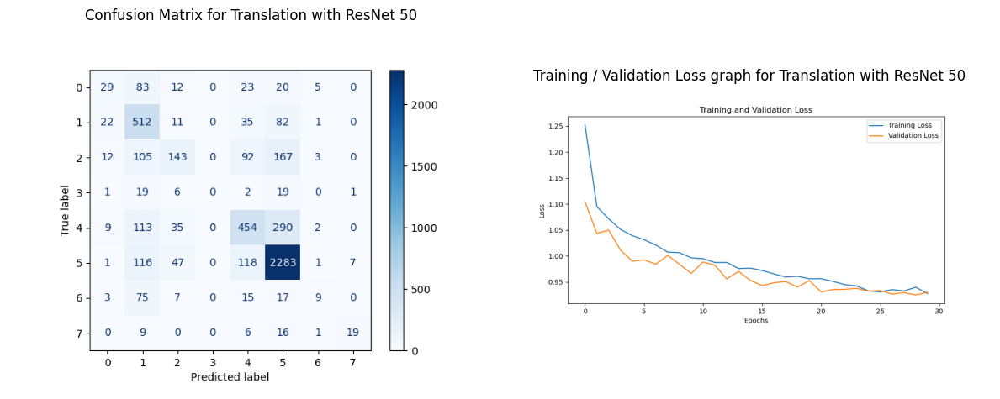

In [ ]:
ResNet_hor_path = os.path.join(ResNet_noteable_imgs, 'Translation')
conf_mat_path = os.path.join(ResNet_hor_path, 'Conf_mat.png')
conf_mat_title = "Confusion Matrix for Translation with ResNet 50"
loss_plot_path = os.path.join(ResNet_hor_path, 'loss.png')
loss_plot_title = "Training / Validation Loss graph for Translation with ResNet 50"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title, "ResNet_2nd_Translate")

####Worst Performer - Noise Injection

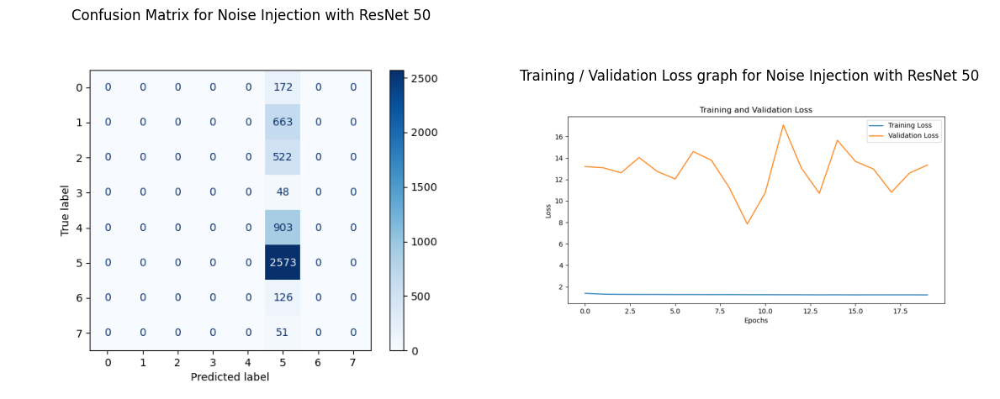

In [ ]:
ResNet_noise_path = os.path.join(ResNet_noteable_imgs, 'Noise')
conf_mat_path = os.path.join(ResNet_noise_path, 'Copy of Conf_mat.png')
conf_mat_title = "Confusion Matrix for Noise Injection with ResNet 50"
loss_plot_path = os.path.join(ResNet_noise_path, 'Copy of loss.png')
loss_plot_title = "Training / Validation Loss graph for Noise Injection with ResNet 50"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title, "ResNet_worst_Noise")

###DenseNet121

####Best Performer - Horizontal Flipping

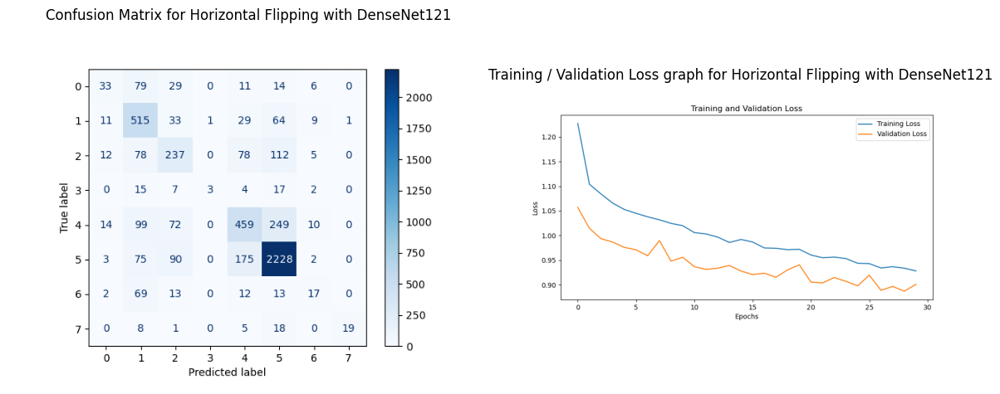

In [ ]:
DenseNet_hor_path = os.path.join(DenseNet_noteable_imgs, 'Hor')
conf_mat_path = os.path.join(DenseNet_hor_path, 'Copy of Conf_mat.png')
conf_mat_title = "Confusion Matrix for Horizontal Flipping with DenseNet121"
loss_plot_path = os.path.join(DenseNet_hor_path, 'Copy of loss.png')
loss_plot_title = "Training / Validation Loss graph for Horizontal Flipping with DenseNet121"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title, "DenseNet_best_Hor")

####Best Performer after Horizontal Flipping - No Augmentation

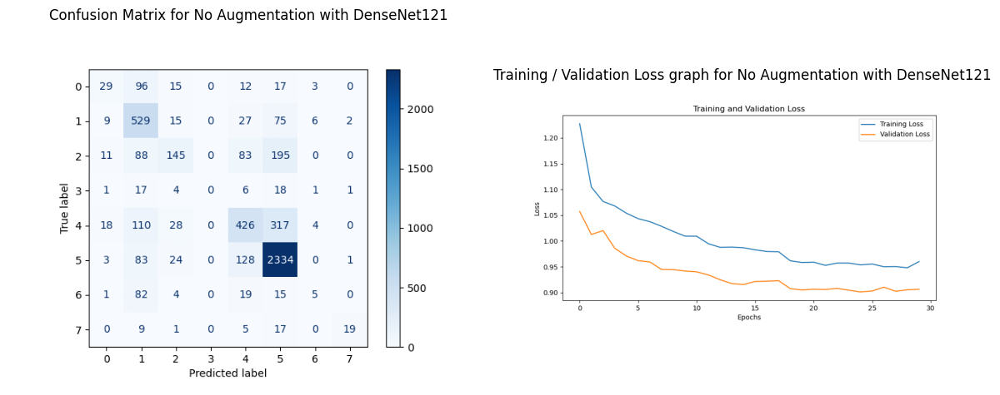

In [ ]:
DenseNet_noaug_path = os.path.join(DenseNet_noteable_imgs, 'No_aug')
conf_mat_path = os.path.join(DenseNet_noaug_path, 'Copy of Conf_mat.png')
conf_mat_title = "Confusion Matrix for No Augmentation with DenseNet121"
loss_plot_path = os.path.join(DenseNet_noaug_path, 'Copy of loss.png')
loss_plot_title = "Training / Validation Loss graph for No Augmentation with DenseNet121"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title, "DenseNet_2nd_NoAugs")

####Worst Performer - Noise Injection

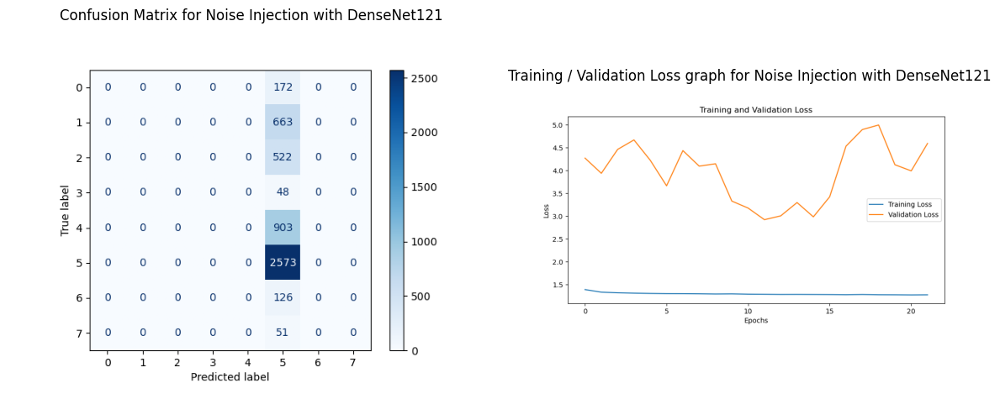

In [ ]:
DenseNet_noise_path = os.path.join(DenseNet_noteable_imgs, 'Noise')
conf_mat_path = os.path.join(DenseNet_noise_path, 'Copy of Conf_mat.png')
conf_mat_title = "Confusion Matrix for Noise Injection with DenseNet121"
loss_plot_path = os.path.join(DenseNet_noise_path, 'Copy of loss.png')
loss_plot_title = "Training / Validation Loss graph for Noise Injection with DenseNet121"

display_images_with_titles(conf_mat_path, conf_mat_title, loss_plot_path, loss_plot_title, "DenseNet_Worst_noise")

#**Results visualisation backup**

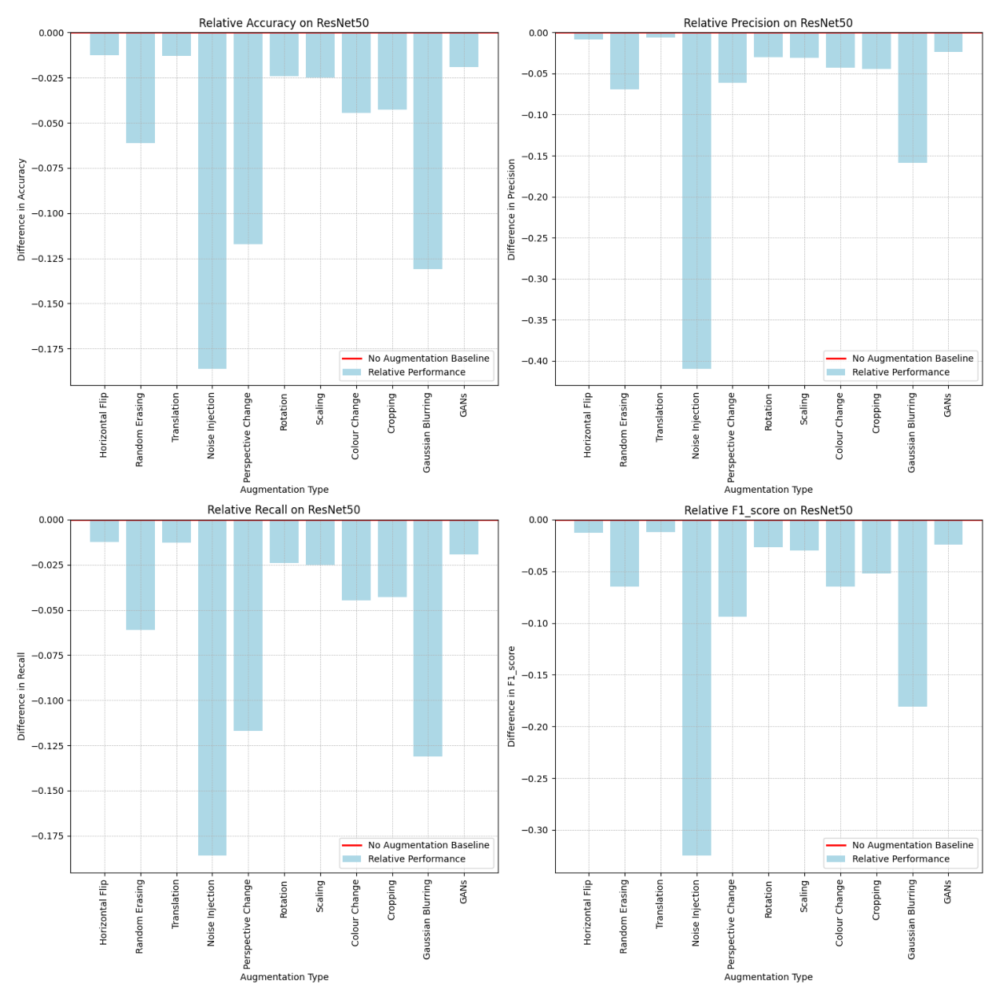

In [ ]:
ResNet50res = os.path.join(save_plots_for_presentation_location, 'ResNet50.png')
img = Image.open(ResNet50res)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

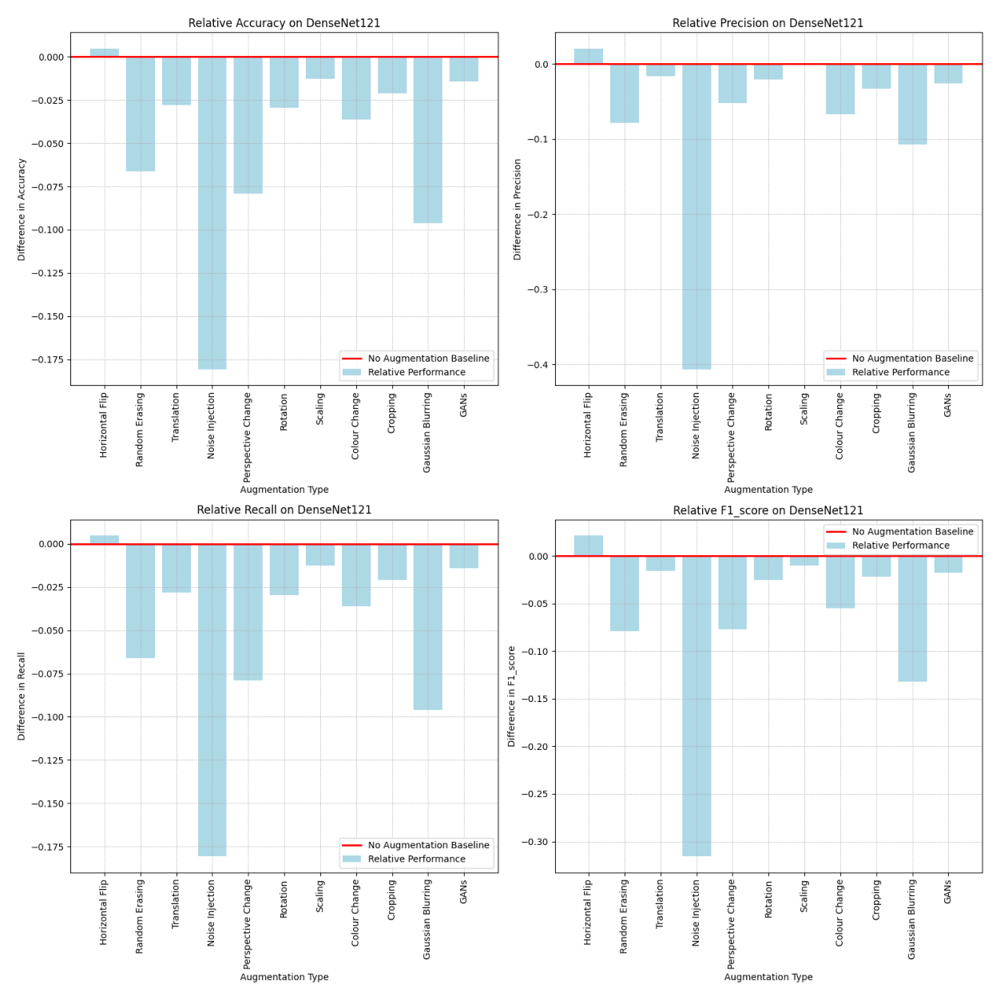

In [ ]:
DenseNet121res = os.path.join(save_plots_for_presentation_location, 'DenseNet121.png')
img = Image.open(DenseNet121res)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

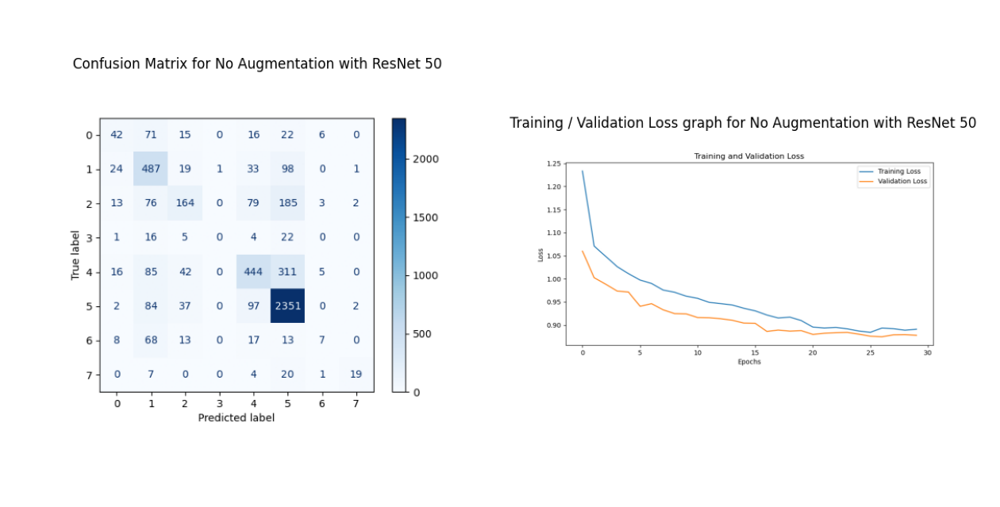

In [ ]:
ResNet_Best_NoAugs = os.path.join(save_plots_for_presentation_location, 'ResNet_Best_NoAugs.png')
img = Image.open(ResNet_Best_NoAugs)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

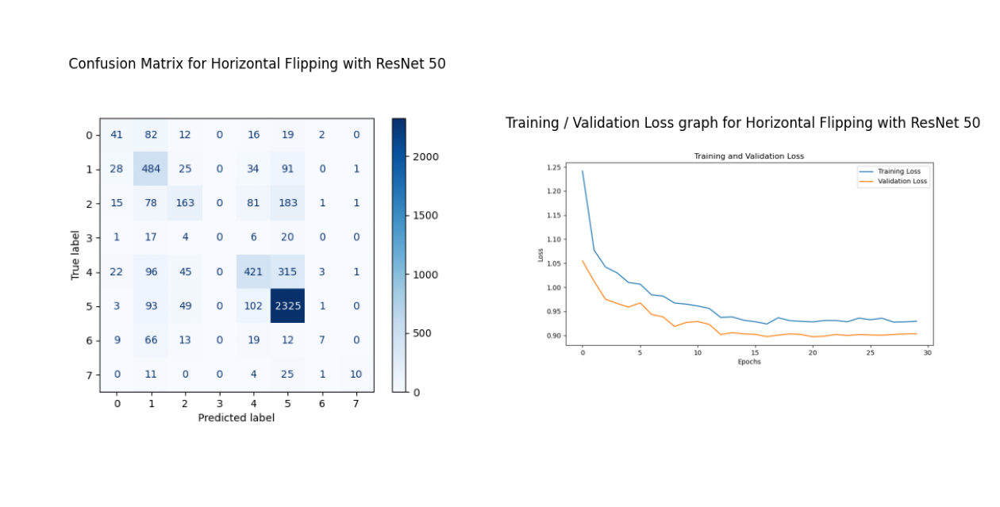

In [ ]:
ResNet_2nd_Hor = os.path.join(save_plots_for_presentation_location, 'ResNet_2nd_Hor.png')
img = Image.open(ResNet_2nd_Hor)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

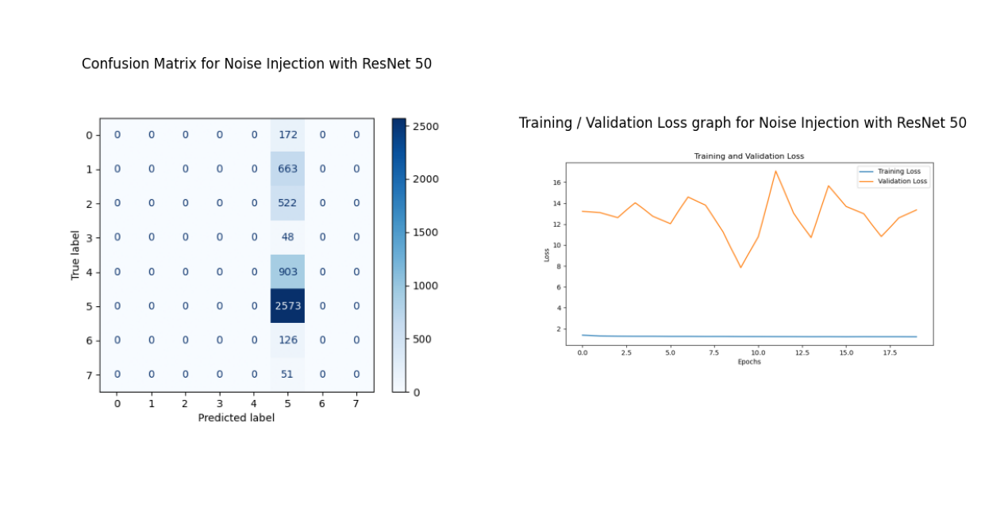

In [ ]:
ResNet_worst_Noise = os.path.join(save_plots_for_presentation_location, 'ResNet_worst_Noise.png')
img = Image.open(ResNet_worst_Noise)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

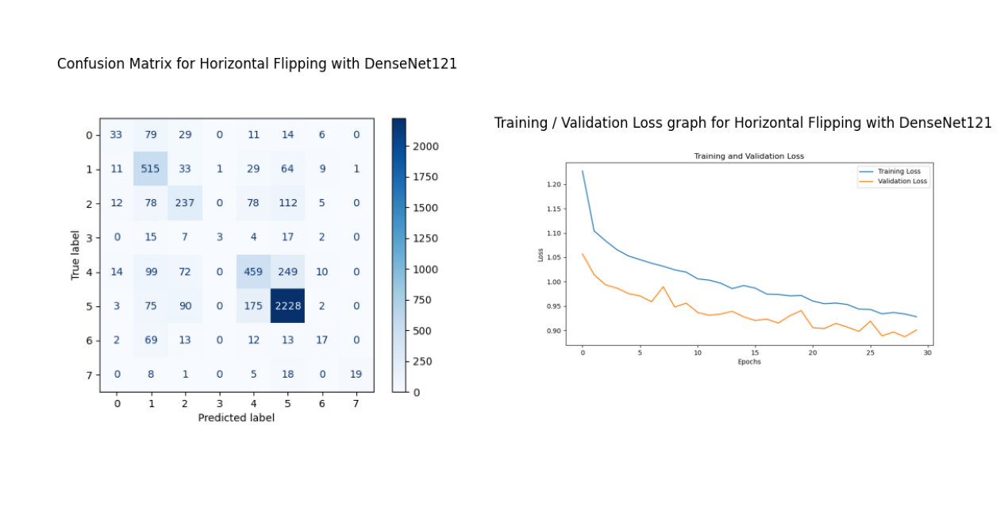

In [ ]:
DenseNet_best_Hor = os.path.join(save_plots_for_presentation_location, 'DenseNet_best_Hor.png')
img = Image.open(DenseNet_best_Hor)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

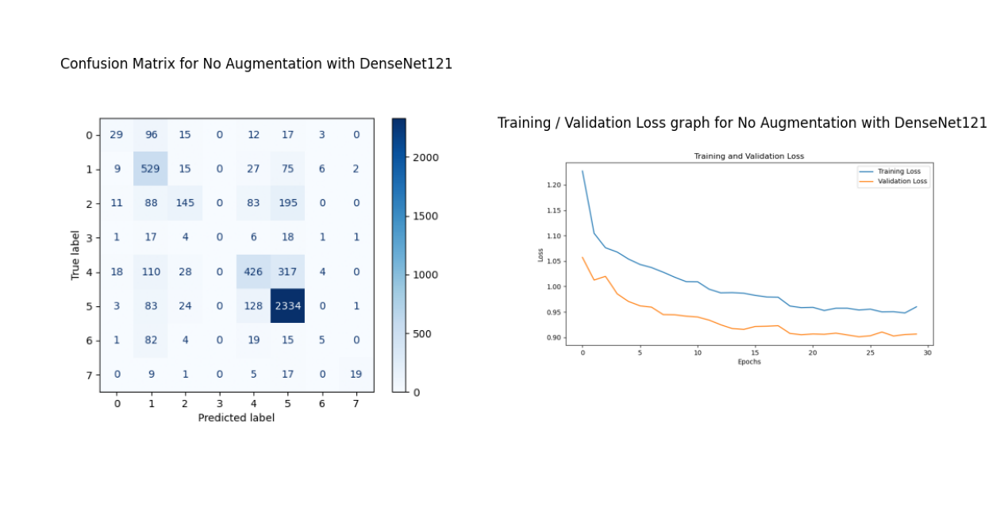

In [ ]:
DenseNet_2nd_NoAugs = os.path.join(save_plots_for_presentation_location, 'DenseNet_2nd_NoAugs.png')
img = Image.open(DenseNet_2nd_NoAugs)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()

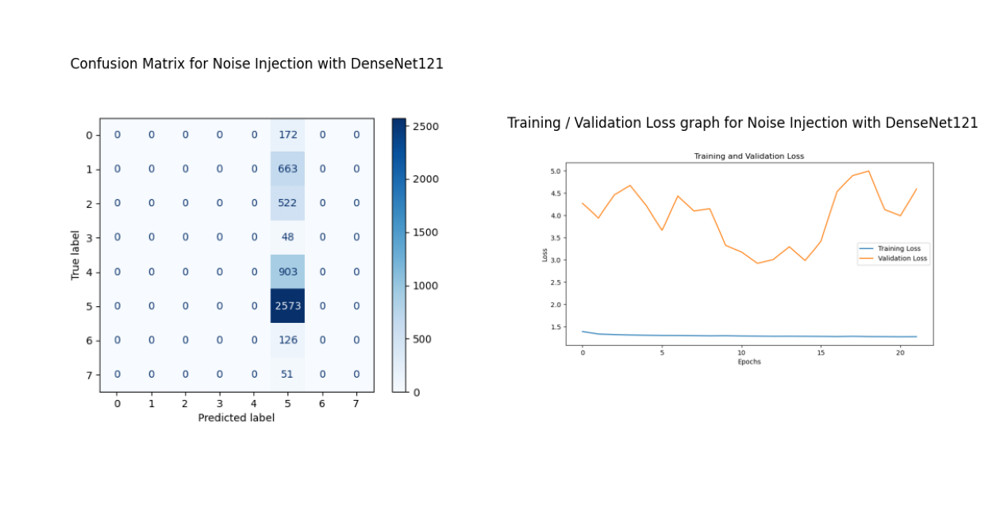

In [ ]:
DenseNet_Worst_noise = os.path.join(save_plots_for_presentation_location, 'DenseNet_Worst_noise.png')
img = Image.open(DenseNet_Worst_noise)
fig, ax = plt.subplots(figsize=(16, 16))

ax.imshow(img)
ax.axis('off')

plt.show()